In [1]:
# pip install pandas pyarrow openpyxl transformers torch umap-learn hdbscan bertopic
import os
import re
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
os.environ["TOKENIZERS_PARALLELISM"] = "false"
import umap
import hdbscan
import gc
import torch
from transformers import LEDTokenizer, LEDModel
from bertopic import BERTopic

# Global config
PATH_X1 = "/Users/jingyi/Desktop/Trauma_LLM/all_patient/data_Hsp12.feather"
PATH_X2 = "/Users/jingyi/Desktop/Trauma_LLM/all_patient/indvd_metric.csv"
PATH_METRIC_DEF = "/Users/jingyi/Desktop/Trauma_LLM/metric_def.xlsx"

EMB_MODEL_NAME = "allenai/led-base-16384"
MAX_TOKENS = 16000
N_COMPONENTS_CLUST = 10   # dimension need to be changed
N_NEIGHBORS = 15

if torch.backends.mps.is_available():
    DEVICE = torch.device("mps")
elif torch.cuda.is_available():
    DEVICE = torch.device("cuda")
else:
    DEVICE = torch.device("cpu")
print("Device:", DEVICE)

Device: mps


In [3]:
# 1. Read X1 feather and show shape
X1 = pd.read_feather(PATH_X1)
print("Original X1 shape:", X1.shape)

cols_to_drop = [
    'mpp_121', 'mpp_125', 'mpp_16', 'mpp_168', 'mpp_236', 'mpp_242', 'mpp_71',
    'proc_01_icd', 'proc_02_icd', 'proc_03_icd', 'proc_04_icd', 'proc_05_icd',
    'proc_06_icd', 'proc_07_icd', 'proc_08_icd', 'proc_09_icd', 'proc_10_icd',
    'proc_11_icd', 'proc_12_icd', 'proc_13_icd', 'proc_14_icd', 'proc_15_icd',
    'proc_16_icd', 'proc_17_icd', 'proc_18_icd', 'proc_19_icd', 'proc_20_icd',
    'proc_21_icd', 'proc_22_icd', 'proc_23_icd', 'proc_24_icd', 'proc_25_icd',
    'proc_26_icd', 'proc_27_icd', 'proc_28_icd', 'proc_29_icd', 'proc_30_icd',
    'proc_31_icd', 'proc_32_icd', 'proc_33_icd', 'proc_34_icd', 'proc_35_icd',
    'proc_36_icd', 'proc_37_icd', 'proc_38_icd', 'proc_39_icd', 'proc_40_icd',
    'proc_41_icd', 'proc_42_icd', 'proc_43_icd', 'proc_44_icd', 'proc_45_icd',
    'proc_46_icd', 'proc_47_icd', 'proc_48_icd', 'proc_49_icd', 'proc_50_icd',
    'proc_51_icd', 'proc_52_icd', 'proc_53_icd', 'proc_54_icd', 'proc_55_icd',
    'proc_56_icd', 'proc_57_icd', 'proc_58_icd', 'proc_59_icd', 'proc_60_icd',
    'proc_61_icd', 'proc_62_icd', 'proc_63_icd', 'proc_64_icd', 'proc_65_icd',
    'proc_66_icd', 'proc_67_icd', 'proc_68_icd', 'proc_69_icd', 'proc_70_icd',
    'proc_71_icd', 'proc_72_icd', 'proc_73_icd', 'proc_74_icd', 'proc_75_icd',
    'proc_76_icd', 'proc_77_icd', 'proc_78_icd', 'proc_79_icd', 'proc_80_icd',
    'proc_81_icd', 'proc_82_icd', 'proc_83_icd', 'proc_84_icd'
]

X1 = X1.drop(columns=cols_to_drop, errors="ignore")
print("X1 shape after dropping cols:", X1.shape)

# 1b. Read X2 csv
X2 = pd.read_csv(PATH_X2)
X2 = X2.drop(columns="QI", errors="ignore")
# Align X2 rows so that inc_key order matches X1
if "inc_key" not in X1.columns or "inc_key" not in X2.columns:
    raise ValueError("Both X1 and X2 must contain 'inc_key' column.")

X2 = X2.set_index("inc_key").reindex(X1["inc_key"]).reset_index()
print("Aligned X2 shape:", X2.shape)

# Assumes X1 and X2 are already loaded and aligned as in your existing code.
X2_features_only = X2.drop(columns=["inc_key"])
X4 = pd.concat([X1, X2_features_only], axis=1)
print("X4 shape:", X4.shape)

Original X1 shape: (103362, 1571)
X1 shape after dropping cols: (103362, 1480)
Aligned X2 shape: (103362, 116)
X4 shape: (103362, 1595)


In [4]:
import json
save_path1 = "/Users/jingyi/Desktop/Trauma_LLM/all_patient/originaldata_text.json"
with open(save_path1, "r", encoding="utf-8") as f:
    X1_texts = json.load(f)

In [5]:
save_path2 = "/Users/jingyi/Desktop/Trauma_LLM/all_patient/indvdmetric_text.json"
with open(save_path2, "r", encoding="utf-8") as f:
    X2_texts = json.load(f)

In [6]:
save_path_merged = "/Users/jingyi/Desktop/Trauma_LLM/all_patient/originaldatametric_text.json"
with open(save_path_merged, "r", encoding="utf-8") as f:
    X4_texts = json.load(f)

In [7]:
#Embeddings
model = LEDModel.from_pretrained(EMB_MODEL_NAME).to(DEVICE)
model.eval()
tokenizer = LEDTokenizer.from_pretrained(EMB_MODEL_NAME)
torch.set_grad_enabled(False)

def mean_pooling(last_hidden_state, attention_mask):
    """
    last_hidden_state: (B, T, H)
    attention_mask: (B, T)
    """
    mask_expanded = attention_mask.unsqueeze(-1).expand(last_hidden_state.size()).float()
    return (last_hidden_state * mask_expanded).sum(1) / mask_expanded.sum(1)

def embed_text_led(text: str,
                   tokenizer=tokenizer,
                   model=model,
                   device=DEVICE,
                   max_length=MAX_TOKENS) -> np.ndarray:
    """
    Embed a single text with LED encoder + mean pooling.
    Returns 1D numpy array (hidden_dim,).
    """
    enc = tokenizer(
        text,
        padding=True,
        truncation=True,
        max_length=max_length,
        return_tensors="pt"
    ).to(device)

    input_ids = enc["input_ids"]
    attention_mask = enc["attention_mask"]

    # Global attention: first token global
    global_attention_mask = torch.zeros_like(input_ids)
    global_attention_mask[:, 0] = 1

    with torch.no_grad():
        encoder_outputs = model.encoder(
            input_ids=input_ids,
            attention_mask=attention_mask,
            global_attention_mask=global_attention_mask
        )
        last_hidden_state = encoder_outputs.last_hidden_state  # (1, T, H)
        emb = mean_pooling(last_hidden_state, attention_mask)  # (1, H)

    return emb.squeeze(0).cpu().numpy().astype(np.float32)  # (H,)

hidden_size = model.config.d_model  # LED hidden size
print("LED hidden size:", hidden_size)


try:
    from tqdm.auto import tqdm
except ImportError:
    tqdm = None

def embed_with_resume(
    texts,
    emb_path,
    tag,
    hidden_size,
    embed_fn=embed_text_led,
    save_every=500,
):
    """
    texts      : list/Series of str
    emb_path   : .npy 
    tag        : “X1”
    hidden_size: embedding dim
    embed_fn   : 
    save_every : checkpoint
    """
    texts = list(texts)
    n_rows = len(texts)
    print(f"[{tag}] Total rows: {n_rows}")

  
    if os.path.exists(emb_path):
        emb = np.load(emb_path)
        if emb.shape != (n_rows, hidden_size):
            print(f"[{tag}] Existing file shape {emb.shape} "
                  f"!= ({n_rows}, {hidden_size}), re-initializing.")
            emb = np.zeros((n_rows, hidden_size), dtype=np.float32)
        else:
            print(f"[{tag}] Loaded existing embeddings from {emb_path}, shape={emb.shape}")
    else:
        print(f"[{tag}] No existing file, initializing empty embedding matrix.")
        emb = np.zeros((n_rows, hidden_size), dtype=np.float32)


    zero_rows = np.where(np.all(emb == 0, axis=1))[0]
    if len(zero_rows) == 0:
        print(f"[{tag}] All {n_rows} rows already embedded. Nothing to do.")
        return emb

    print(f"[{tag}] Need to compute {len(zero_rows)} / {n_rows} missing rows.")

    if tqdm is not None:
        iterator = tqdm(zero_rows, desc=f"{tag} embeddings", unit="row")
    else:
        iterator = zero_rows

    updates_since_save = 0


    for idx in iterator:

        if not np.all(emb[idx] == 0):
            continue

        emb[idx] = embed_fn(texts[idx])
        updates_since_save += 1


        if updates_since_save >= save_every:
            np.save(emb_path, emb)
            updates_since_save = 0
            if tqdm is None:
   
                print(f"[{tag}] Checkpoint saved at row {idx+1}/{n_rows}")

        if DEVICE.type != "cuda":
            gc.collect()


    np.save(emb_path, emb)
    print(f"[{tag}] Done. Saved final embeddings to {emb_path}")

    return emb

# ====== 3. X1: embedding ======

EMB_PATH_X1 = "/Users/jingyi/Desktop/Trauma_LLM/all_patient/originaldata_LED_emb_103362.npy"

X1_emb = embed_with_resume(
    texts=X1_texts,
    emb_path=EMB_PATH_X1,
    tag="X1",
    hidden_size=hidden_size,
    embed_fn=embed_text_led,
    save_every=500,    
)

print("X1_emb final shape:", X1_emb.shape)

# inc_key 
X1[["inc_key"]].to_csv(
    "/Users/jingyi/Desktop/Trauma_LLM/all_patient/originaldata_inc_key.csv",
    index=False
)

# ====== 4. X2 embedding ======

EMB_PATH_X2 = "/Users/jingyi/Desktop/Trauma_LLM/all_patient/indvdmetric_LED_emb.npy"

X2_emb = embed_with_resume(
    texts=X2_texts,
    emb_path=EMB_PATH_X2,
    tag="X2",
    hidden_size=hidden_size,
    embed_fn=embed_text_led,
    save_every=500,
)

print("X2_emb final shape:", X2_emb.shape)

X2[["inc_key"]].to_csv(
    "/Users/jingyi/Desktop/Trauma_LLM/all_patient/indvdmetric_inc_key.csv",
    index=False
)

LED hidden size: 768
[X1] Total rows: 103362
[X1] Loaded existing embeddings from /Users/jingyi/Desktop/Trauma_LLM/all_patient/originaldata_LED_emb_103362.npy, shape=(103362, 768)
[X1] All 103362 rows already embedded. Nothing to do.
X1_emb final shape: (103362, 768)
[X2] Total rows: 103362
[X2] Loaded existing embeddings from /Users/jingyi/Desktop/Trauma_LLM/all_patient/indvdmetric_LED_emb.npy, shape=(103362, 768)
[X2] All 103362 rows already embedded. Nothing to do.
X2_emb final shape: (103362, 768)


In [8]:
# ============================================
# SECTION 2 — Embedding X4_texts (same logic as X1/X2)
# ============================================
import json
import numpy as np

EMB_PATH_X4 = "/Users/jingyi/Desktop/Trauma_LLM/all_patient/originaldatametric_LED_emb.npy"

# If X4_texts not in memory, reload from disk
if "X4_texts" not in globals():
    save_path_merged = "/Users/jingyi/Desktop/Trauma_LLM/all_patient/originaldatametric_text.json"
    with open(save_path_merged, "r", encoding="utf-8") as f:
        X4_texts = json.load(f)

# Use the same helper as for X1_emb and X2_emb
X4_emb = embed_with_resume(
    texts=X4_texts,
    emb_path=EMB_PATH_X4,
    tag="X4",
    hidden_size=hidden_size,
    embed_fn=embed_text_led,
    save_every=500,
)

print("X4_emb final shape:", X4_emb.shape)
X4[["inc_key"]].to_csv(
    "/Users/jingyi/Desktop/Trauma_LLM/all_patient/originaldatametric_inc_key.csv",
    index=False
)

[X4] Total rows: 103362
[X4] Loaded existing embeddings from /Users/jingyi/Desktop/Trauma_LLM/all_patient/originaldatametric_LED_emb.npy, shape=(103362, 768)
[X4] All 103362 rows already embedded. Nothing to do.
X4_emb final shape: (103362, 768)


In [9]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import normalize

# Load your data (Your existing code)
#X1_emb = np.load("/Users/jingyi/Desktop/Trauma_LLM/all_patient/originaldata_LED_emb_103362.npy")
#X2_emb = np.load("/Users/jingyi/Desktop/Trauma_LLM/all_patient/indvdmetric_LED_emb.npy")

X1_inc_key = pd.read_csv("/Users/jingyi/Desktop/Trauma_LLM/all_patient/originaldata_inc_key.csv")
X2_inc_key = pd.read_csv("/Users/jingyi/Desktop/Trauma_LLM/all_patient/indvdmetric_inc_key.csv")
X4_inc_key = pd.read_csv("/Users/jingyi/Desktop/Trauma_LLM/all_patient/originaldatametric_inc_key.csv")

print("Original shapes:")
print(X1_emb.shape, X1_inc_key.shape)
print(X2_emb.shape, X2_inc_key.shape)
print(X4_emb.shape, X4_inc_key.shape)

# --- NORMALIZATION STEP ---

# L2 Normalization maps all vectors to the unit sphere
# This makes Euclidean distance equivalent to Cosine distance
print("\nNormalizing embeddings...")
X1_emb = normalize(X1_emb, norm='l2')
X2_emb = normalize(X2_emb, norm='l2')
X4_emb = normalize(X4_emb, norm='l2')

print("Normalization complete.")

Original shapes:
(103362, 768) (103362, 1)
(103362, 768) (103362, 1)
(103362, 768) (103362, 1)

Normalizing embeddings...
Normalization complete.


In [12]:
def average_pairwise_cosine_similarity_sampled(
    X: np.ndarray,
    n_pair_samples: int = 100_000,
    random_state: int = 42
) -> float:
    
    rng = np.random.default_rng(random_state)
    X = np.asarray(X, dtype=np.float32)
    n, d = X.shape

    # Random pair indices (i, j)
    idx_i = rng.integers(0, n, size=n_pair_samples)
    idx_j = rng.integers(0, n, size=n_pair_samples)

    # avoid i == j; for large n this is rare, but we can filter
    mask = idx_i != idx_j
    idx_i = idx_i[mask]
    idx_j = idx_j[mask]

    # Cosine similarity = dot of normalized vectors
    v_i = X[idx_i]
    v_j = X[idx_j]
    cos_vals = np.sum(v_i * v_j, axis=1)

    return float(cos_vals.mean())


# Example usage (sampled for X1_emb)
avg_cos_X1_sampled = average_pairwise_cosine_similarity_sampled(X1_emb, n_pair_samples=200_000)
print("Approx. average pairwise cosine similarity for X1_emb (sampled):", avg_cos_X1_sampled)
avg_cos_X2_sampled = average_pairwise_cosine_similarity_sampled(X2_emb, n_pair_samples=200_000)
print("Approx. average pairwise cosine similarity for X2_emb (sampled):", avg_cos_X2_sampled)
avg_cos_X4_sampled = average_pairwise_cosine_similarity_sampled(X4_emb, n_pair_samples=200_000)
print("Approx. average pairwise cosine similarity for X4_emb (sampled):", avg_cos_X4_sampled)

Approx. average pairwise cosine similarity for X1_emb (sampled): 0.9969326853752136
Approx. average pairwise cosine similarity for X2_emb (sampled): 0.979410707950592
Approx. average pairwise cosine similarity for X4_emb (sampled): 0.9974551200866699


[I 2025-12-05 11:59:37,355] A new study created in memory with name: no-name-1c9582eb-fc00-4eca-9feb-53cf577a7d50



========== X4: Stage 1 — Bayesian optimization on DBCV ==========


[I 2025-12-05 12:01:10,938] Trial 0 finished with value: 0.4308525039311613 and parameters: {'n_neighbors': 43, 'min_dist': 0.0405994359164869, 'min_cluster_size': 345, 'min_samples': 90}. Best is trial 0 with value: 0.4308525039311613.
[I 2025-12-05 12:02:06,999] Trial 1 finished with value: -0.5474178240996996 and parameters: {'n_neighbors': 15, 'min_dist': 0.3649431409831881, 'min_cluster_size': 214, 'min_samples': 57}. Best is trial 0 with value: 0.4308525039311613.
[I 2025-12-05 12:03:56,742] Trial 2 finished with value: -0.484840501849023 and parameters: {'n_neighbors': 52, 'min_dist': 0.26060755172947125, 'min_cluster_size': 299, 'min_samples': 45}. Best is trial 0 with value: 0.4308525039311613.
[I 2025-12-05 12:04:52,591] Trial 3 finished with value: 0.5165674195062877 and parameters: {'n_neighbors': 15, 'min_dist': 0.11828948813620321, 'min_cluster_size': 239, 'min_samples': 28}. Best is trial 3 with value: 0.5165674195062877.
[I 2025-12-05 12:06:49,714] Trial 4 finished with

[X4] Best trial value (DBCV): 0.8910556030208729
[X4] Best trial params: {'n_neighbors': 16, 'min_dist': 0.027616357656951307, 'min_cluster_size': 379, 'min_samples': 10}
[X4] #candidate trials for stability (within 0.02 of best): 3
[X4] params={'n_neighbors': 16, 'min_dist': 0.027616357656951307, 'min_cluster_size': 379, 'min_samples': 10}
    BO DBCV=0.8911, full DBCV=0.8979, mean ARI=0.9722, std=0.0314
[X4] params={'n_neighbors': 16, 'min_dist': 0.06029329658780032, 'min_cluster_size': 326, 'min_samples': 14}
    BO DBCV=0.8799, full DBCV=0.8633, mean ARI=0.9906, std=0.0043
[X4] params={'n_neighbors': 17, 'min_dist': 0.05803700010054251, 'min_cluster_size': 355, 'min_samples': 21}
    BO DBCV=0.8748, full DBCV=0.8728, mean ARI=0.9876, std=0.0182

[X4] Final chosen params (high DBCV + high ARI):
{'n_neighbors': 16, 'min_dist': 0.06029329658780032, 'min_cluster_size': 326, 'min_samples': 14}
    BO DBCV: 0.879873165857596
    Full DBCV: 0.8633123592224281
    mean ARI: 0.9906186867893

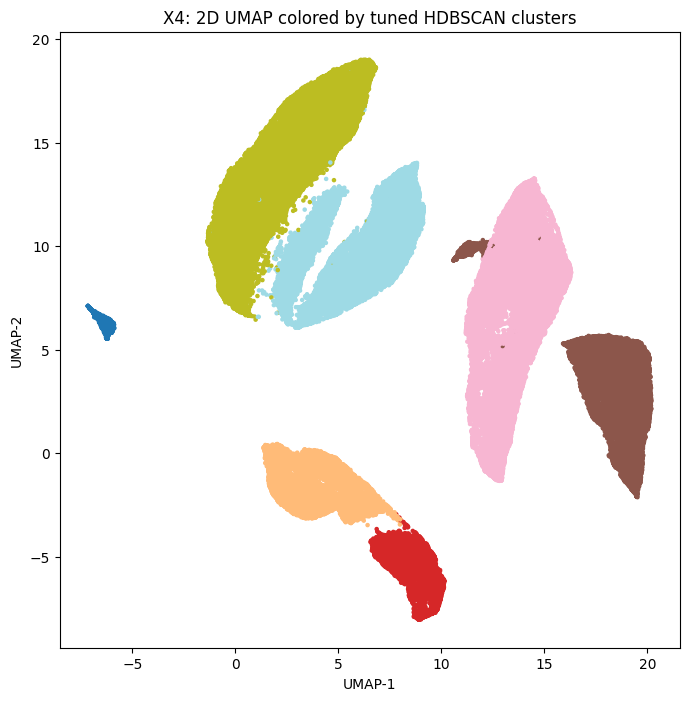

In [42]:
# ============================================
# SECTION 3 — BO + stability for X2_emb and X4_emb (new selection rule)
# ============================================
import numpy as np
import umap
import hdbscan
import optuna
from sklearn.metrics import adjusted_rand_score
from collections import Counter
import matplotlib.pyplot as plt


def run_umap_hdbscan_for_params(
    X,
    n_neighbors: int,
    min_dist: float,
    min_cluster_size: int,
    min_samples: int,
    n_components_clust: int,
    random_state: int = 42,
):
    """
    For a given dataset X and hyperparameters, run:
      1) UMAP to n_components_clust dimensions
      2) HDBSCAN clustering on the UMAP embedding

    Returns
    -------
    labels : np.ndarray
        Cluster labels (including -1 for noise).
    dbcv : float
        HDBSCAN's relative_validity_ as an approximate DBCV score.
        If n_clusters < 2, returns -1.0.
    X_umap : np.ndarray
        The UMAP embedding used for clustering.
    """
    # 1) UMAP embedding for clustering space
    umap_model = umap.UMAP(
        n_neighbors=n_neighbors,
        n_components=n_components_clust,
        min_dist=min_dist,
        metric="euclidean",
        random_state=random_state,
    )
    X_umap = umap_model.fit_transform(X)

    # 2) HDBSCAN clustering
    clusterer = hdbscan.HDBSCAN(
        min_cluster_size=min_cluster_size,
        min_samples=min_samples,
        metric="euclidean",
        cluster_selection_method="eom",
        gen_min_span_tree=True,  # 确保 relative_validity_ 可用
    )
    labels = clusterer.fit_predict(X_umap)

    # 有效簇数量（排除 -1）
    n_clusters = len(set(labels)) - (1 if -1 in labels else 0)

    # 如果簇太少，直接返回很差的分数
    if n_clusters < 2:
        return labels, -1.0, X_umap

    # HDBSCAN 自带的 approximate DBCV 指标
    dbcv = float(clusterer.relative_validity_)

    return labels, dbcv, X_umap


def evaluate_stability_with_ari(
    params: dict,
    X,
    n_components_clust: int,
    n_subsamples: int = 20,
    subsample_ratio: float = 0.8,
    random_state: int = 123,
):
    """
    Evaluate clustering stability for given hyperparameters using ARI:

      1) Run UMAP+HDBSCAN on full X to get baseline labels and DBCV.
      2) Repeat:
         - randomly subsample subsample_ratio of X
         - recluster that subset with the same params
         - compute ARI between subset labels and corresponding full-data labels
      3) Return mean/std of ARI and full-data DBCV.
    """
    rng = np.random.RandomState(random_state)

    # ---- full-data baseline ----
    labels_full, dbcv_full, _ = run_umap_hdbscan_for_params(
        X=X,
        n_neighbors=params["n_neighbors"],
        min_dist=params["min_dist"],
        min_cluster_size=params["min_cluster_size"],
        min_samples=params["min_samples"],
        n_components_clust=n_components_clust,
        random_state=777,  # 固定 full-data 的 UMAP random_state
    )

    n_samples = X.shape[0]
    ari_scores = []

    for _ in range(n_subsamples):
        idx = rng.choice(n_samples, int(subsample_ratio * n_samples), replace=False)
        X_sub = X[idx]

        # 对子样本重新跑一次聚类（random_state 每次不同）
        labels_sub, _, _ = run_umap_hdbscan_for_params(
            X=X_sub,
            n_neighbors=params["n_neighbors"],
            min_dist=params["min_dist"],
            min_cluster_size=params["min_cluster_size"],
            min_samples=params["min_samples"],
            n_components_clust=n_components_clust,
            random_state=rng.randint(0, 10**6),
        )

        # 对齐 full-data 的对应行
        labels_full_sub = labels_full[idx]
        ari = adjusted_rand_score(labels_full_sub, labels_sub)
        ari_scores.append(ari)

    mean_ari = float(np.mean(ari_scores))
    std_ari = float(np.std(ari_scores))
    return mean_ari, std_ari, float(dbcv_full)


def objective_for_embedding(trial, X_emb):
    """
    Optuna 的目标函数：给一组超参数 -> 返回加了惩罚项的综合得分（以 DBCV 为主）
    惩罚内容：
      - 希望簇数量在 [5, 15] 之间
      - 希望不要出现一个簇占了绝大部分样本（例如 > 50%）
    """
    # 搜索空间（你可以按需要再调）
    n_neighbors = trial.suggest_int("n_neighbors", 10, 80)
    min_dist = trial.suggest_float("min_dist", 0.0, 0.5)
    min_cluster_size = trial.suggest_int("min_cluster_size", 50, 400)
    min_samples = trial.suggest_int("min_samples", 5, 100)

    # 跑一次 UMAP + HDBSCAN
    labels, dbcv, _ = run_umap_hdbscan_for_params(
        X=X_emb,
        n_neighbors=n_neighbors,
        min_dist=min_dist,
        min_cluster_size=min_cluster_size,
        min_samples=min_samples,
        n_components_clust=N_COMPONENTS_CLUST,
        random_state=42,  
    )

    unique_labels = set(labels)
    if -1 in unique_labels:
        unique_labels.remove(-1)
    n_clusters = len(unique_labels)

    # 如果聚类失败或只有 1 个簇：直接给很差分数
    if n_clusters < 2:
        return -1.0

    noise_ratio = float(np.mean(labels == -1))

    # 计算每个簇的大小和最大簇占比
    cluster_sizes = np.array([np.sum(labels == c) for c in unique_labels])
    total_cluster_points = cluster_sizes.sum()
    largest_cluster_ratio = cluster_sizes.max() / total_cluster_points

    # -------------------------
    # 基础目标：DBCV
    # -------------------------
    dbcv = float(dbcv)

    # （保留你原来的两个“软惩罚”，可选）
    if noise_ratio > 0.99:
        dbcv -= 0.1  # 几乎全是噪声，减分
    if n_clusters > 50:
        dbcv -= 0.05  # 簇太多，稍微减分

    # -------------------------
    # 新增 1：簇数量惩罚（希望 5–15 个簇）
    # -------------------------
    target_min_clusters = 7
    target_max_clusters = 15
    penalty_weight_clusters = 0.5  # 惩罚强度，你可以调大/调小

    if n_clusters < target_min_clusters:
        dbcv -= penalty_weight_clusters * (target_min_clusters - n_clusters)
    elif n_clusters > target_max_clusters:
        dbcv -= penalty_weight_clusters * (n_clusters - target_max_clusters)

    # -------------------------
    # 新增 2：超级大簇惩罚（最大簇占比 > 50%）
    # -------------------------
    max_allowed_ratio = 0.4
    penalty_weight_giant = 1  # 惩罚强度，你可以调大/调小

    if largest_cluster_ratio > max_allowed_ratio:
        dbcv -= penalty_weight_giant * (largest_cluster_ratio - max_allowed_ratio)

    return dbcv

def run_bo_and_stability_for_embedding(
    X_emb,
    tag,
    epsilon=0.02,
    max_candidates=15,
    n_trials=50,
    n_subsamples=20,
    subsample_ratio=0.8,
):
    print(f"\n========== {tag}: Stage 1 — Bayesian optimization on DBCV ==========")
    study = optuna.create_study(direction="maximize")
    study.optimize(lambda trial: objective_for_embedding(trial, X_emb), n_trials=n_trials)

    print(f"[{tag}] Best trial value (DBCV):", study.best_value)
    print(f"[{tag}] Best trial params:", study.best_params)

    # ---- New candidate selection rule ----
    best_value = study.best_value
    candidate_trials = [
        t for t in study.trials
        if (t.value is not None) and (t.value >= best_value - epsilon)
    ]
    candidate_trials.sort(key=lambda t: t.value, reverse=True)

    if len(candidate_trials) > max_candidates:
        candidate_trials = candidate_trials[:max_candidates]

    print(f"[{tag}] #candidate trials for stability (within {epsilon} of best):",
          len(candidate_trials))

    # ---- Stage 2: stability with ARI ----
    stability_results = []

    for t in candidate_trials:
        params = t.params
        mean_ari, std_ari, dbcv_full = evaluate_stability_with_ari(
            params=params,
            X=X_emb,
            n_components_clust=N_COMPONENTS_CLUST,
            n_subsamples=n_subsamples,
            subsample_ratio=subsample_ratio,
            random_state=123,
        )
        rec = {
            "params": params,
            "bo_dbcv": t.value,
            "full_dbcv": dbcv_full,
            "mean_ari": mean_ari,
            "std_ari": std_ari,
        }
        stability_results.append(rec)
        print(f"[{tag}] params={params}")
        print(f"    BO DBCV={t.value:.4f}, full DBCV={dbcv_full:.4f}, "
              f"mean ARI={mean_ari:.4f}, std={std_ari:.4f}")

    best_stable = max(stability_results, key=lambda d: d["mean_ari"])
    BEST_PARAMS = best_stable["params"]

    print(f"\n[{tag}] Final chosen params (high DBCV + high ARI):")
    print(BEST_PARAMS)
    print("    BO DBCV:", best_stable["bo_dbcv"])
    print("    Full DBCV:", best_stable["full_dbcv"])
    print("    mean ARI:", best_stable["mean_ari"], "std:", best_stable["std_ari"])

    return BEST_PARAMS, stability_results


def run_final_clustering_and_2d_umap(X_emb, best_params, tag):
    """
    Same spirit as your Stage 3, but generalized.
    """
    N_NEIGHBORS_final = best_params["n_neighbors"]
    MIN_DIST_final = best_params["min_dist"]
    MIN_CLUSTER_SIZE_final = best_params["min_cluster_size"]
    MIN_SAMPLES_final = best_params["min_samples"]

    print(f"\n[{tag}] Running final UMAP ({N_COMPONENTS_CLUST}D) + HDBSCAN with best params")
    umap_clust = umap.UMAP(
        n_neighbors=N_NEIGHBORS_final,
        n_components=N_COMPONENTS_CLUST,
        min_dist=MIN_DIST_final,
        metric="euclidean",
        random_state=42,
    )
    X_umap_d = umap_clust.fit_transform(X_emb)

    hdb = hdbscan.HDBSCAN(
        min_cluster_size=MIN_CLUSTER_SIZE_final,
        min_samples=MIN_SAMPLES_final,
        metric="euclidean",
        cluster_selection_method="eom",
        gen_min_span_tree=True,
    )
    labels = hdb.fit_predict(X_umap_d)
    print(f"[{tag}] clusters (excluding -1):", set(labels) - {-1})
    print(f"[{tag}] cluster size counts:", Counter(labels))

    # 2D UMAP for visualization
    print(f"[{tag}] Running 2D UMAP for visualization...")
    umap_2d = umap.UMAP(
        n_neighbors=15,
        n_components=2,
        min_dist=0.1,
        metric="cosine",
        random_state=42,
    )
    X_umap_2d = umap_2d.fit_transform(X_emb)

    plt.figure(figsize=(8, 8))
    plt.scatter(X_umap_2d[:, 0], X_umap_2d[:, 1], c=labels, s=5, cmap="tab20")
    plt.title(f"{tag}: 2D UMAP colored by tuned HDBSCAN clusters")
    plt.xlabel("UMAP-1")
    plt.ylabel("UMAP-2")
    plt.show()

    return labels, X_umap_d, X_umap_2d


# ---- Run for X2_emb and X4_emb ----
#BEST_PARAMS_X1, stability_X1 = run_bo_and_stability_for_embedding(
    #X1_emb, tag="X1", epsilon=0.02)
#BEST_PARAMS_X2, stability_X2 = run_bo_and_stability_for_embedding(
    #X2_emb, tag="X2", epsilon=0.02)

BEST_PARAMS_X4, stability_X4 = run_bo_and_stability_for_embedding(
    X4_emb, tag="X4", epsilon=0.02)

#X1_labels, X1_umap_d, X1_umap_2d = run_final_clustering_and_2d_umap(
    #X1_emb, BEST_PARAMS_X1, tag="X1")
    
#X2_labels, X2_umap_d, X2_umap_2d = run_final_clustering_and_2d_umap(
    #X2_emb, BEST_PARAMS_X2, tag="X2")
X4_labels, X4_umap_d, X4_umap_2d = run_final_clustering_and_2d_umap(
    X4_emb, BEST_PARAMS_X4, tag="X4")

In [11]:
# setting UMAP_x4
# Section 5: UMAP to N_COMPONENTS_CLUST dims for clustering

print("Running UMAP to", N_COMPONENTS_CLUST, "dims for X4...")
umap_clust_X4 = umap.UMAP(
    n_neighbors=16,
    n_components=10,
    min_dist=0.027616357656951307,
    metric="euclidean",
    random_state=42
)
X4_umap_d = umap_clust_X4.fit_transform(X4_emb)
print("X4_umap_d shape:", X4_umap_d.shape)

Running UMAP to 10 dims for X4...


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


X4_umap_d shape: (103362, 10)


In [12]:
# Section 6: HDBSCAN clustering on UMAP space_x4

from collections import Counter

print("Clustering X4 with HDBSCAN...")
hdbscan_X4 = hdbscan.HDBSCAN(
    min_cluster_size=379,
    metric="euclidean",
    cluster_selection_method="eom",
    min_samples=10,
)
X4_labels = hdbscan_X4.fit_predict(X4_umap_d)

# Count all labels (including noise = -1)
label_counts = Counter(X4_labels)
print("Cluster size counts (including noise):", label_counts)

# Print noise cluster size
noise_count = label_counts.get(-1, 0)
print(f"Number of points in noise cluster (label = -1): {noise_count}")

# Print non-noise clusters
print("X4 clusters (excluding -1):", set(X4_labels) - {-1})

# For coloring later
X4_colors = X4_labels

Clustering X4 with HDBSCAN...
Cluster size counts (including noise): Counter({np.int64(1): 27153, np.int64(5): 24173, np.int64(2): 19329, np.int64(6): 15594, np.int64(3): 10943, np.int64(4): 5206, np.int64(0): 964})
Number of points in noise cluster (label = -1): 0
X4 clusters (excluding -1): {np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6)}


In [13]:
  import numpy as np

  np.savez(
      "X4_umap_hdbscan_outputs.npz",
      X4_umap_d=X4_umap_d,
      X4_labels=X4_labels
  )
  print("Saved X4_umap_hdbscan_outputs.npz")

Saved X4_umap_hdbscan_outputs.npz


In [14]:
  import numpy as np

  data = np.load("X4_umap_hdbscan_outputs.npz")

  X4_umap_d = data["X4_umap_d"]
  X4_labels = data["X4_labels"]

  print("Loaded X4_umap_d shape:", X4_umap_d.shape)
  print("Loaded X4_labels shape:", X4_labels.shape)
  print("Unique clusters (excluding -1):", set(X4_labels) - {-1})

Loaded X4_umap_d shape: (103362, 10)
Loaded X4_labels shape: (103362,)
Unique clusters (excluding -1): {np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6)}


In [19]:
#cosine mean cluster
import numpy as np
from sklearn.preprocessing import normalize

def mean_cosine_within_between(
    X_emb,
    labels,
    max_pairs_within=200_000,
    max_pairs_between=200_000,
    ignore_noise=True,
    random_state=42,
):
    rng = np.random.default_rng(random_state)

    # 1) L2-normalize embeddings so cosine = dot product
    X_norm = normalize(X_emb, axis=1)

    # 2) Filter noise if needed
    if ignore_noise:
        mask = labels != -1
        X_norm = X_norm[mask]
        labels = labels[mask]

    # Safety: if no data or only one cluster, bail out
    unique_clusters = np.unique(labels)
    if len(unique_clusters) < 2:
        raise ValueError("Need at least 2 clusters (excluding noise) to compute between-cluster similarity.")

    # --- 3) Mean cosine WITHIN clusters (sampled) ---
    within_sims = []
    # Split budget roughly per cluster
    pairs_per_cluster = max_pairs_within // len(unique_clusters)

    for c in unique_clusters:
        idx = np.where(labels == c)[0]
        n_c = len(idx)
        if n_c < 2:
            continue

        # total possible pairs = n_c * (n_c - 1) / 2
        max_pairs_c = n_c * (n_c - 1) // 2
        n_pairs_c = min(pairs_per_cluster, max_pairs_c)

        # sample pairs (i, j) without replacement in indices
        # we'll just sample indices with replacement but ensure i != j
        for _ in range(n_pairs_c):
            i, j = rng.choice(idx, size=2, replace=False)
            sim = np.dot(X_norm[i], X_norm[j])  # cosine because normalized
            within_sims.append(sim)

    mean_cos_within = float(np.mean(within_sims)) if len(within_sims) > 0 else np.nan

    # --- 4) Mean cosine BETWEEN clusters (sampled) ---
    between_sims = []

    # Pre-store indices for each cluster so sampling is easy
    cluster_to_indices = {c: np.where(labels == c)[0] for c in unique_clusters}
    cluster_list = list(unique_clusters)
    n_cluster = len(cluster_list)

    if n_cluster >= 2:
        # Sample between-cluster pairs by choosing two different clusters, then one point from each
        for _ in range(max_pairs_between):
            c1, c2 = rng.choice(cluster_list, size=2, replace=False)
            i = rng.choice(cluster_to_indices[c1])
            j = rng.choice(cluster_to_indices[c2])
            sim = np.dot(X_norm[i], X_norm[j])
            between_sims.append(sim)

    mean_cos_between = float(np.mean(between_sims)) if len(between_sims) > 0 else np.nan

    return mean_cos_within, mean_cos_between

mean_within, mean_between = mean_cosine_within_between(X1_emb, X1_colors)

print("Mean cosine (within clusters):", mean_within)
print("Mean cosine (between clusters):", mean_between)


Mean cosine (within clusters): 0.9982811808586121
Mean cosine (between clusters): 0.9946140646934509


In [21]:
#global mean
import numpy as np
from sklearn.preprocessing import normalize

def mean_cosine_within_between_all(
    X_emb,
    labels,
    ignore_noise=True,
):

    # 1) L2-normalize so cosine = dot product
    X_norm = normalize(X_emb, axis=1)

    # 2) Optionally drop noise points
    labels = np.asarray(labels)
    if ignore_noise:
        mask = labels != -1
        X_norm = X_norm[mask]
        labels = labels[mask]

    unique_clusters = np.unique(labels)
    if len(unique_clusters) < 1:
        raise ValueError("No clusters found (after ignoring noise).")
    if len(unique_clusters) < 2:
        # You can still compute within, but between is undefined
        print("Warning: only one cluster present; between-cluster mean will be NaN.")

    # 3) Precompute cluster sizes and vector sums
    cluster_sums = {}
    cluster_sizes = {}
    for c in unique_clusters:
        idx = (labels == c)
        X_c = X_norm[idx]
        cluster_sizes[c] = X_c.shape[0]
        cluster_sums[c] = X_c.sum(axis=0)

    # 4) WITHIN-cluster mean (exact, all pairs)
    total_within_sum = 0.0      # sum of cos over all within-cluster pairs (unordered)
    total_within_pairs = 0      # total number of unordered within-cluster pairs
    cluster_within_means = {}

    for c in unique_clusters:
        n_c = cluster_sizes[c]
        if n_c < 2:
            cluster_within_means[c] = np.nan
            continue

        s_c = cluster_sums[c]           # sum of vectors in cluster c
        s_norm_sq = float(np.dot(s_c, s_c))  # ||s_c||^2

        # sum over all unordered pairs (i<j) in cluster c
        # sum_pairs_c = (||s_c||^2 - n_c) / 2
        sum_pairs_c = (s_norm_sq - n_c) / 2.0

        # number of unordered pairs in cluster c
        num_pairs_c = n_c * (n_c - 1) / 2.0

        mean_c = sum_pairs_c / num_pairs_c
        cluster_within_means[c] = mean_c

        total_within_sum += sum_pairs_c
        total_within_pairs += num_pairs_c

    mean_within_global = (
        total_within_sum / total_within_pairs if total_within_pairs > 0 else np.nan
    )

    # 5) BETWEEN-cluster mean (exact, all cross-cluster pairs)
    total_between_sum = 0.0
    total_between_pairs = 0.0

    cluster_list = list(unique_clusters)
    K = len(cluster_list)

    if K >= 2:
        for i in range(K):
            ci = cluster_list[i]
            s_i = cluster_sums[ci]
            n_i = cluster_sizes[ci]

            for j in range(i + 1, K):
                cj = cluster_list[j]
                s_j = cluster_sums[cj]
                n_j = cluster_sizes[cj]

                # sum of cos over all pairs (x in ci, y in cj)
                # = s_i · s_j
                sum_pairs_ij = float(np.dot(s_i, s_j))
                num_pairs_ij = float(n_i * n_j)

                total_between_sum += sum_pairs_ij
                total_between_pairs += num_pairs_ij

        mean_between_global = (
            total_between_sum / total_between_pairs
            if total_between_pairs > 0
            else np.nan
        )
    else:
        mean_between_global = np.nan

    return mean_within_global, mean_between_global, cluster_within_means
mean_within, mean_between, within_by_cluster = \
    mean_cosine_within_between_all(X1_emb, X1_colors)

print("Global mean cosine within clusters:", mean_within)
print("Global mean cosine between clusters:", mean_between)
print("Per-cluster mean within:", within_by_cluster)

Global mean cosine within clusters: 0.9981196602094904
Global mean cosine between clusters: 0.9959156898204062
Per-cluster mean within: {np.int64(0): 0.9986992987270866, np.int64(1): 0.9980924749333338, np.int64(2): 0.998065194571206, np.int64(3): 0.9982719851802266}


Running 2D UMAP for X4...
X4_umap_2d shape: (103362, 2)


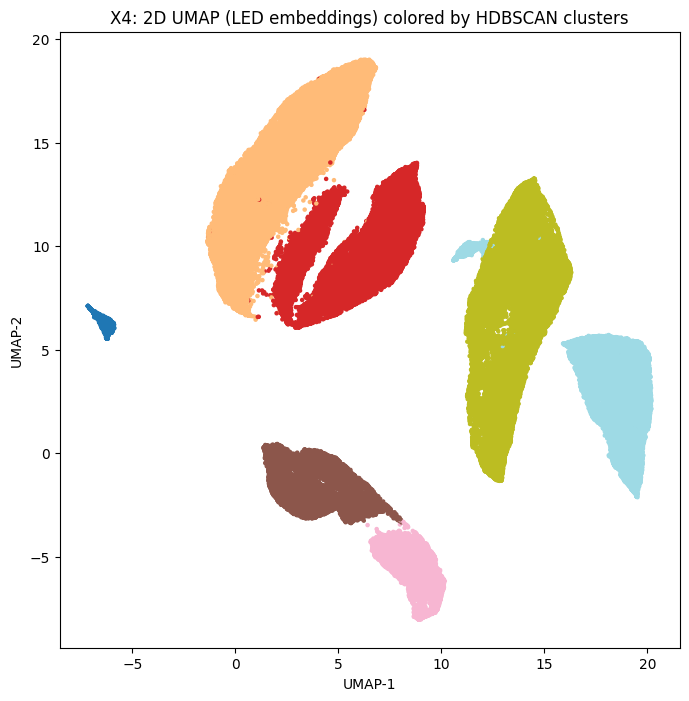

In [18]:
# Section 7: 2D UMAP + scatter plots

print("Running 2D UMAP for X4...")
umap_2d_X4 = umap.UMAP(
    n_neighbors=15,
    n_components=2,
    min_dist=0.1,
    metric="cosine",
    random_state=42
)
X4_umap_2d = umap_2d_X4.fit_transform(X4_emb)
print("X4_umap_2d shape:", X4_umap_2d.shape)

plt.figure(figsize=(8, 8))
plt.scatter(X4_umap_2d[:, 0], X4_umap_2d[:, 1], c=X4_colors, s=5, cmap="tab20")
plt.title("X4: 2D UMAP (LED embeddings) colored by HDBSCAN clusters")
plt.xlabel("UMAP-1"); plt.ylabel("UMAP-2")
plt.show()

In [19]:
import numpy as np
import plotly.express as px

labels = np.asarray(X4_colors)

# Decide a stable cluster ordering (noise first, then sorted cluster ids)
cluster_ids = sorted([c for c in np.unique(labels) if c != -1])
cluster_order = [-1] + cluster_ids

# Choose a palette (hex colors) that both Plotly + Matplotlib can use
palette = px.colors.qualitative.Plotly  # or Safe, D3, Dark24, etc.

# Map each cluster label -> hex color (cycle if more clusters than palette)
label_to_color = {-1: "#BDBDBD"}  # noise = gray
for i, c in enumerate(cluster_ids):
    label_to_color[c] = palette[i % len(palette)]

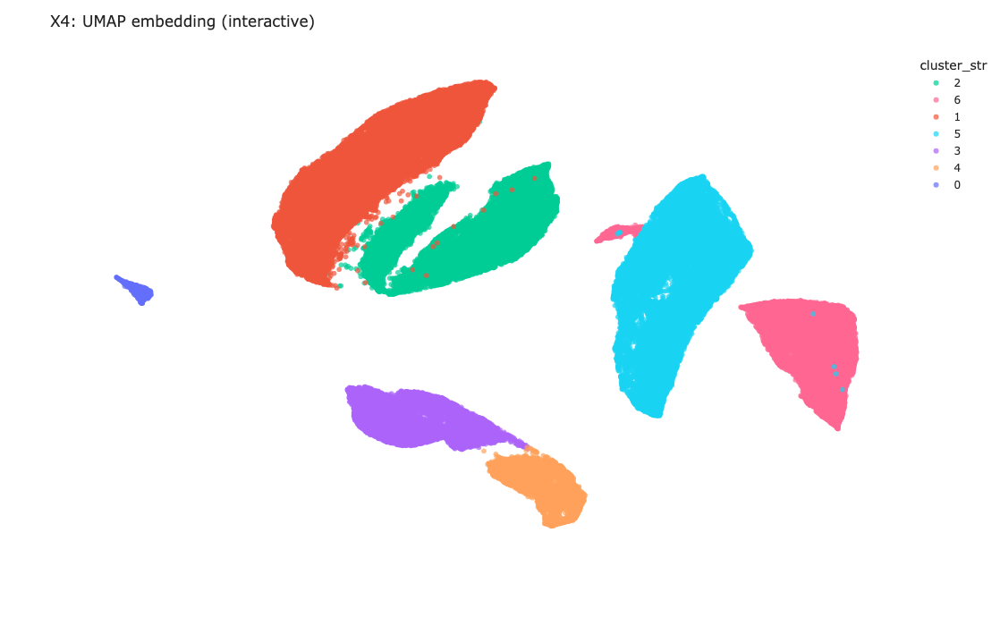

In [20]:
import plotly.express as px
import pandas as pd
import numpy as np

X4_inc_key = X4["inc_key"].values
coords = np.asarray(X4_umap_2d)
labels = np.asarray(X4_labels)

df_plot = pd.DataFrame({
    "UMAP1": coords[:, 0],
    "UMAP2": coords[:, 1],
    "cluster": labels,
    "inc_key": X4_inc_key
})

# make string labels for Plotly + map colors consistently
df_plot["cluster_str"] = df_plot["cluster"].astype(str)
df_plot.loc[df_plot["cluster"] == -1, "cluster_str"] = "noise"

color_discrete_map = {"noise": label_to_color[-1]}
for c in sorted([c for c in np.unique(labels) if c != -1]):
    color_discrete_map[str(c)] = label_to_color[c]

fig = px.scatter(
    df_plot,
    x="UMAP1",
    y="UMAP2",
    color="cluster_str",
    color_discrete_map=color_discrete_map,   # <- key line
    hover_data=["inc_key", "cluster"],
    opacity=0.7,
    width=900,
    height=700
)

fig.update_layout(
    title="X4: UMAP embedding (interactive)",
    xaxis_showgrid=False,
    yaxis_showgrid=False,
    xaxis_visible=False,
    yaxis_visible=False,
    template="simple_white"
)

fig.show()

Running 3D UMAP for X4 (visualization only)...
X4_umap_3d shape: (103362, 3)


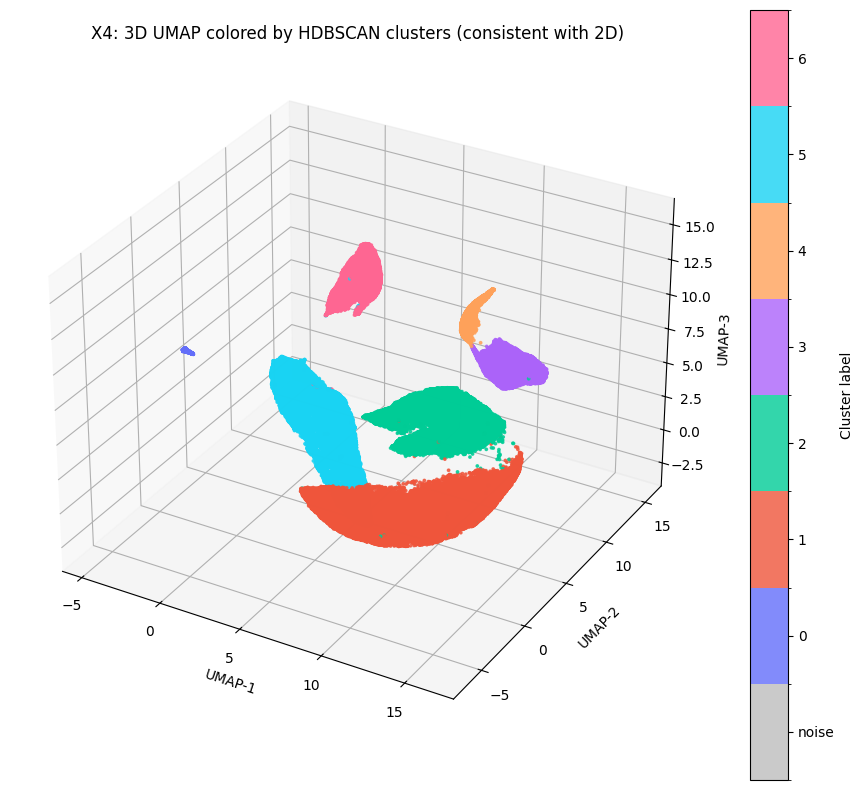

In [33]:
import umap
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401

labels = np.asarray(X4_colors)

print("Running 3D UMAP for X4 (visualization only)...")
umap_3d_X4 = umap.UMAP(
    n_neighbors=15,
    n_components=3,
    min_dist=0.1,
    metric="cosine",
    random_state=42,
)

X4_umap_3d = umap_3d_X4.fit_transform(X4_emb)
print("X4_umap_3d shape:", X4_umap_3d.shape)

# --- Build a Matplotlib colormap that matches label_to_color exactly ---
cluster_ids = sorted([c for c in np.unique(labels) if c != -1])
cluster_order = [-1] + cluster_ids  # index 0 = noise

# label -> index (for colorbar + cmap lookup)
label_to_idx = {c: i for i, c in enumerate(cluster_order)}
idx = np.array([label_to_idx[c] for c in labels])

# ordered list of colors matching cluster_order indices
colors_ordered = [label_to_color[c] for c in cluster_order]
cmap = ListedColormap(colors_ordered)

# boundaries so each integer index gets one solid color
bounds = np.arange(-0.5, len(cluster_order) + 0.5, 1)
norm = BoundaryNorm(bounds, cmap.N)

fig = plt.figure(figsize=(9, 8))
ax = fig.add_subplot(111, projection="3d")

sc = ax.scatter(
    X4_umap_3d[:, 0],
    X4_umap_3d[:, 1],
    X4_umap_3d[:, 2],
    c=idx,            # <- indices, not raw labels
    cmap=cmap,
    norm=norm,
    s=3,
    alpha=0.8,
)

ax.set_title("X4: 3D UMAP colored by HDBSCAN clusters (consistent with 2D)")
ax.set_xlabel("UMAP-1")
ax.set_ylabel("UMAP-2")
ax.set_zlabel("UMAP-3")

cb = fig.colorbar(sc, ax=ax, shrink=1)
cb.set_label("Cluster label")
cb.set_ticks(range(len(cluster_order)))
cb.set_ticklabels(["noise" if c == -1 else str(c) for c in cluster_order])

plt.tight_layout()
plt.show()

Running 3D UMAP for X4 (visualization only)...
X4_umap_3d shape: (103362, 3)


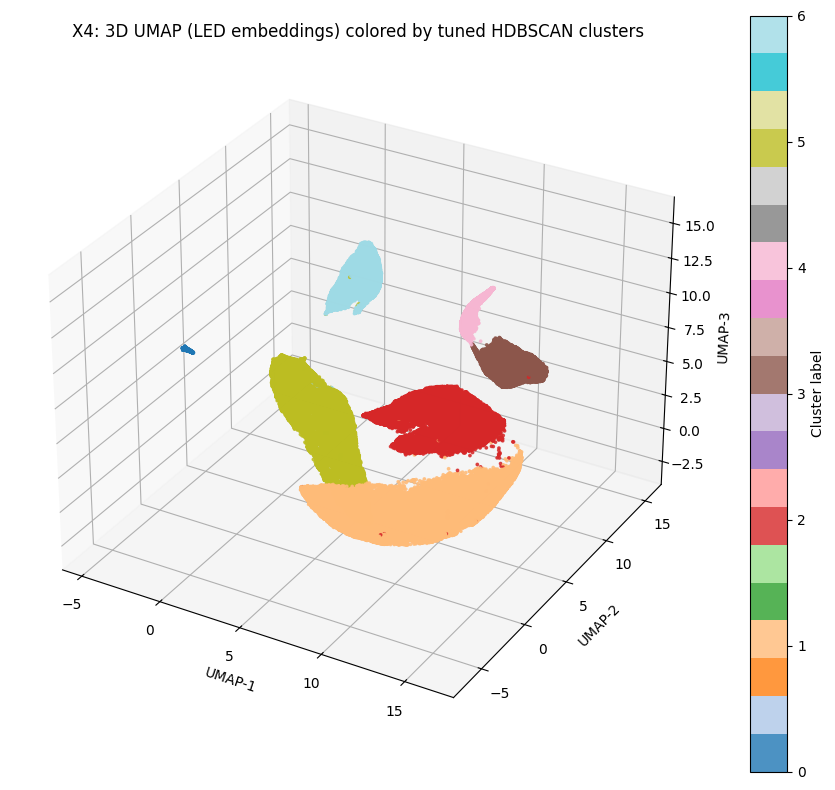

In [49]:
#3D
import umap
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401  # needed for 3D projection

print("Running 3D UMAP for X4 (visualization only)...")
umap_3d_X4 = umap.UMAP(
    n_neighbors=15,
    n_components=3,   # 3D for visualization
    min_dist=0.1,
    metric="cosine",
    random_state=42,
)

X4_umap_3d = umap_3d_X4.fit_transform(X4_emb)
print("X4_umap_3d shape:", X4_umap_3d.shape)

fig = plt.figure(figsize=(9, 8))
ax = fig.add_subplot(111, projection="3d")

sc = ax.scatter(
    X4_umap_3d[:, 0],
    X4_umap_3d[:, 1],
    X4_umap_3d[:, 2],
    c=X4_colors,      # HDBSCAN cluster colors
    s=3,
    cmap="tab20",
    alpha=0.8,
)

ax.set_title("X4: 3D UMAP (LED embeddings) colored by tuned HDBSCAN clusters")
ax.set_xlabel("UMAP-1")
ax.set_ylabel("UMAP-2")
ax.set_zlabel("UMAP-3")

cb = fig.colorbar(sc, ax=ax, shrink=1)
cb.set_label("Cluster label")

plt.tight_layout()
plt.show()

In [ ]:
import umap
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401  # needed for 3D projection

print("Running 3D UMAP for X1 (visualization only)...")
umap_3d_X1 = umap.UMAP(
    n_neighbors=15,
    n_components=3,   # 3D for visualization
    min_dist=0.1,
    metric="cosine",
    random_state=42,
)

X1_umap_3d = umap_3d_X1.fit_transform(X1_emb)
print("X1_umap_3d shape:", X1_umap_3d.shape)

fig = plt.figure(figsize=(9, 8))
ax = fig.add_subplot(111, projection="3d")

sc = ax.scatter(
    X1_umap_3d[:, 0],
    X1_umap_3d[:, 1],
    X1_umap_3d[:, 2],
    c=X1_colors,      # HDBSCAN cluster colors
    s=3,
    cmap="tab20",
    alpha=0.8,
)

ax.set_title("X1: 3D UMAP (LED embeddings) colored by tuned HDBSCAN clusters")
ax.set_xlabel("UMAP-1")
ax.set_ylabel("UMAP-2")
ax.set_zlabel("UMAP-3")

cb = fig.colorbar(sc, ax=ax, shrink=1)
cb.set_label("Cluster label")

plt.tight_layout()
plt.show()

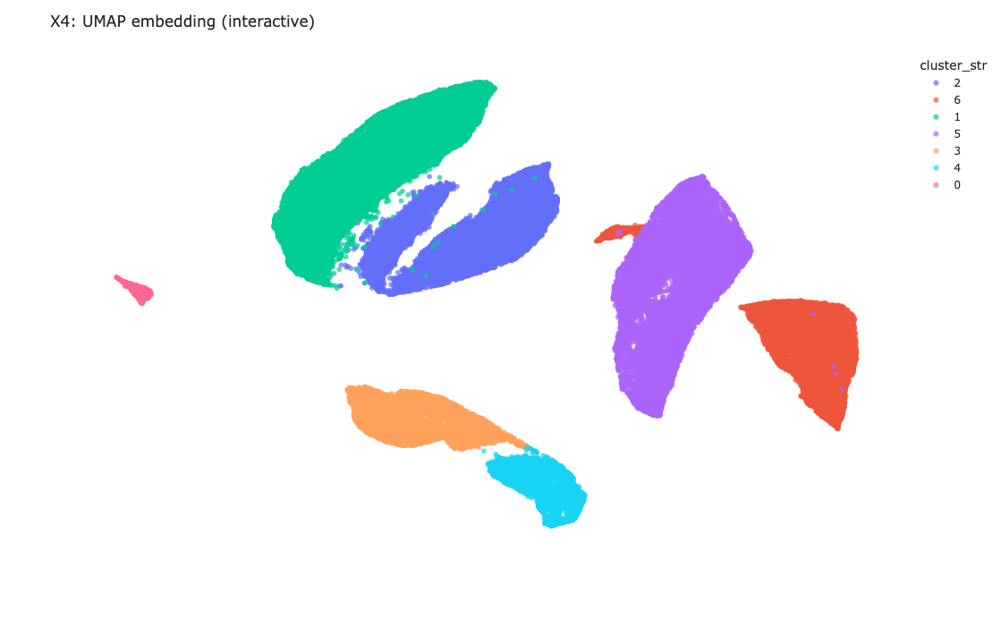

In [57]:
# ==== Section: Interactive UMAP plot with Plotly ====
import plotly.express as px
import pandas as pd
X4_inc_key = X4["inc_key"].values
coords = X4_umap_2d
labels = X4_labels

df_plot = pd.DataFrame({
    "UMAP1": coords[:, 0],
    "UMAP2": coords[:, 1],
    "cluster": labels,
    "inc_key": X4_inc_key   
})


df_plot["cluster_str"] = df_plot["cluster"].astype(str)
df_plot.loc[df_plot["cluster"] == -1, "cluster_str"] = "noise"

fig = px.scatter(
    df_plot,
    x="UMAP1",
    y="UMAP2",
    color="cluster_str",
    hover_data=["inc_key", "cluster"],   
    opacity=0.7,
    width=900,
    height=700
)

fig.update_layout(
    title="X4: UMAP embedding (interactive)",
    xaxis_showgrid=False,
    yaxis_showgrid=False,
    xaxis_visible=False,
    yaxis_visible=False,
    template="simple_white"
)

fig.show()

In [ ]:
import plotly.express as px
import pandas as pd
X1_inc_key = X1["inc_key"].values
coords = X1_umap_2d
labels = X1_labels

df_plot = pd.DataFrame({
    "UMAP1": coords[:, 0],
    "UMAP2": coords[:, 1],
    "cluster": labels,
    "inc_key": X1_inc_key   
})


df_plot["cluster_str"] = df_plot["cluster"].astype(str)
df_plot.loc[df_plot["cluster"] == -1, "cluster_str"] = "noise"

fig = px.scatter(
    df_plot,
    x="UMAP1",
    y="UMAP2",
    color="cluster_str",
    hover_data=["inc_key", "cluster"],   
    opacity=0.7,
    width=900,
    height=700
)

fig.update_layout(
    title="X1: UMAP embedding (interactive)",
    xaxis_showgrid=False,
    yaxis_showgrid=False,
    xaxis_visible=False,
    yaxis_visible=False,
    template="simple_white"
)

fig.show()

In [45]:
#output the interactive plot for X1
import plotly.io as pio

# Example: if your figure is called fig_X1
pio.write_html(
    fig,
    file="/Users/jingyi/Desktop/X1_umap_interactive.html",
    auto_open=False   # set True if you want it to open immediately
)

In [50]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_distances, cosine_similarity

# 1. Prepare labels and coordinates (exclude noise label = -1)
labels = np.asarray(X4_labels)
mask_valid = (labels != -1)

coords_10d = X4_umap_d[mask_valid]
labels_valid = labels[mask_valid]

cluster_ids = np.unique(labels_valid)

# 2. Compute cluster centroids in 10D UMAP space
centroids = []
for k in cluster_ids:
    centroids.append(coords_10d[labels_valid == k].mean(axis=0))
centroids = np.vstack(centroids)   # shape: (n_clusters, 10)

# 3. Compute cosine distance and similarity matrices
dist_mat = cosine_distances(centroids)            # smaller = more similar
sim_mat  = cosine_similarity(centroids)           # larger = more similar

# 4. Wrap into DataFrames for nicer labels
df_dist = pd.DataFrame(dist_mat, 
                       index=cluster_ids, 
                       columns=cluster_ids)

df_sim = pd.DataFrame(sim_mat, 
                      index=cluster_ids, 
                      columns=cluster_ids)

print("Distance matrix shape:", df_dist.shape)
print(df_dist.head())

Distance matrix shape: (7, 7)
          0         1         2         3         4         5         6
0  0.000000  0.188225  0.174216  0.291805  0.296223  0.332685  0.273961
1  0.188225  0.000000  0.067320  0.216213  0.218810  0.102085  0.092642
2  0.174216  0.067320  0.000000  0.201656  0.205306  0.099533  0.096032
3  0.291805  0.216213  0.201656  0.000000  0.092103  0.124268  0.102884
4  0.296223  0.218810  0.205306  0.092103  0.000000  0.122220  0.107228


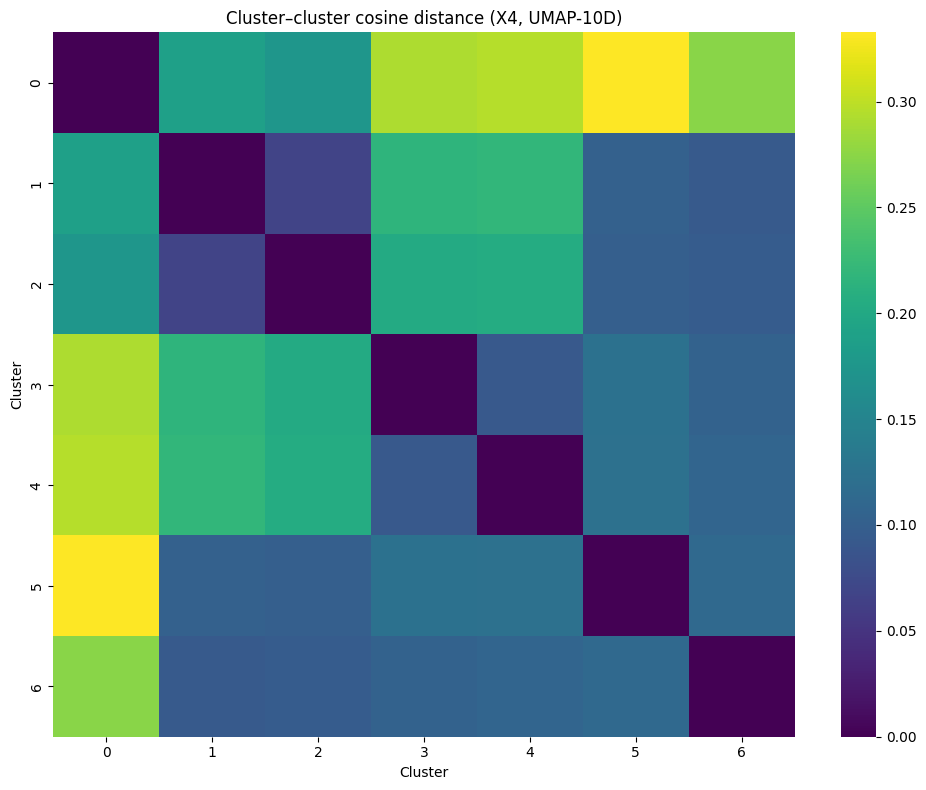

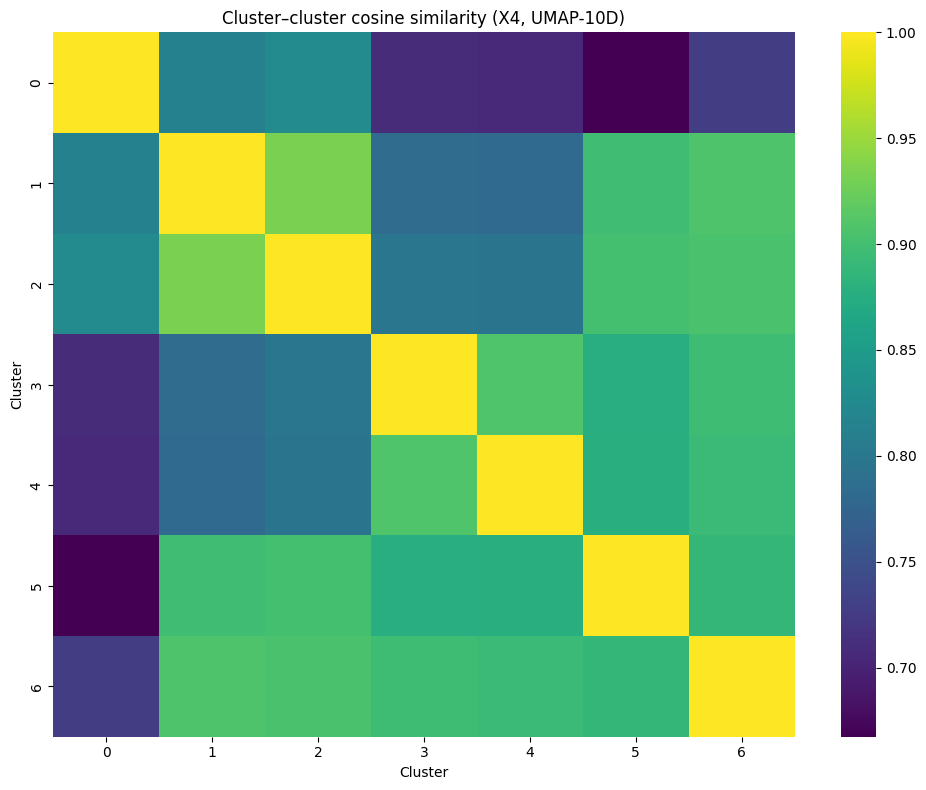

In [51]:
plt.figure(figsize=(10, 8))
sns.heatmap(df_dist, cmap="viridis")   # or "magma", "coolwarm", etc.
plt.title("Cluster–cluster cosine distance (X4, UMAP-10D)")
plt.xlabel("Cluster")
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 8))
sns.heatmap(df_sim, cmap="viridis")
plt.title("Cluster–cluster cosine similarity (X4, UMAP-10D)")
plt.xlabel("Cluster")
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

In [15]:
import pandas as pd
import numpy as np
from scipy.stats import kruskal

PATH_X2 = "/Users/jingyi/Desktop/Trauma_LLM/all_patient/indvd_metric.csv"

# 1. Read X2
X2 = pd.read_csv(PATH_X2)

# 2. Define the QI column name here
QI_COL = "QI"   # <-- CHANGE THIS IF YOUR COLUMN IS NAMED DIFFERENTLY

# 3. Keep only inc_key and QI
needed_cols = ["inc_key", QI_COL]
missing = [c for c in needed_cols if c not in X2.columns]
if missing:
    raise ValueError(f"These columns are missing in X2: {missing}")

X3 = X2[needed_cols].copy()

# 4. Clean QI: make sure it's numeric, drop rows with missing QI
X3[QI_COL] = pd.to_numeric(X3[QI_COL], errors="coerce")
X3 = X3.dropna(subset=[QI_COL])

print("X3 shape (inc_key + QI):", X3.shape)
print(X3.head())

X3 shape (inc_key + QI): (103362, 2)
   inc_key        QI
0        1  0.655087
1     1000  0.734867
2    10000  0.848347
3   100000  0.666016
4   100001  0.653150


In [16]:

X4_df = X4.reset_index(drop=True)

if "inc_key" not in X4.columns:
    raise ValueError("X4 does not have an 'inc_key' column.")

# Ensure inc_key types match
X3["inc_key"] = X3["inc_key"].astype(X4["inc_key"].dtype)

# Merge QI onto X1 patients
X4_qi = X4_df[["inc_key"]].copy()
X4_qi = X4_qi.merge(X3, on="inc_key", how="left")

print("Rows in X4_qi:", len(X4_qi))
print("Missing QI in X4_qi:", X4_qi[QI_COL].isna().sum())
print(X4_qi.head())

Rows in X4_qi: 103362
Missing QI in X4_qi: 0
   inc_key        QI
0        1  0.655087
1        2  0.599881
2      111  0.695792
3      112  0.699126
4      113  0.776029


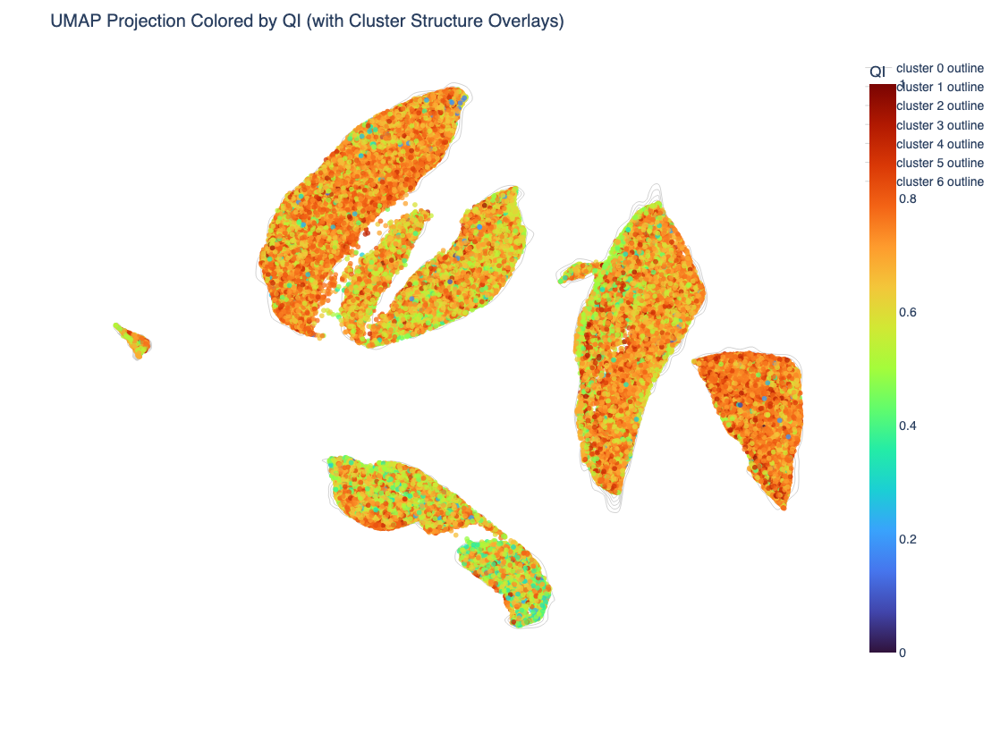

In [21]:
  import numpy as np
  import pandas as pd
  import plotly.express as px
  import plotly.graph_objects as go

  # ---- inputs you already have ----
 
  # Build plotting dataframe
  X4_inc_key = X4["inc_key"].values
  coords = np.asarray(X4_umap_2d)
  labels = np.asarray(X4_labels)

  df_plot = pd.DataFrame({
      "UMAP1": coords[:, 0],
      "UMAP2": coords[:, 1],
      "cluster": labels,
      "inc_key": X4_inc_key
  })

  # Merge QI (ensure X1_qi has inc_key + QI_COL)
  df_plot = df_plot.merge(X4_qi[["inc_key", QI_COL]], on="inc_key", how="left")

  # Optional: drop missing QI for color
  df_plot = df_plot.dropna(subset=[QI_COL])

  # Create base scatter with continuous QI color
  fig = px.scatter(
      df_plot,
      x="UMAP1",
      y="UMAP2",
      color=QI_COL,
      color_continuous_scale="Turbo",
      hover_data={"inc_key": True, "cluster": True, QI_COL: ':.3f'},
      opacity=0.75,
      width=1000,
      height=820
  )
  # (skip noise cluster -1)
  for c in sorted([c for c in np.unique(labels) if c != -1]):
      sub = df_plot[df_plot["cluster"] == c]
      if len(sub) > 200:  # avoid small noisy contours
          fig.add_trace(
              go.Histogram2dContour(
                  x=sub["UMAP1"],
                  y=sub["UMAP2"],
                  contours=dict(coloring="none"),
                  line=dict(width=1, color="rgba(0,0,0,0.18)"),
                  showscale=False,
                  hoverinfo="skip",
                  name=f"cluster {c} outline"
              )
          )

  # Styling for a polished, scientific look
  fig.update_layout(
      title="UMAP Projection Colored by QI (with Cluster Structure Overlays)",
      template="plotly_white",
      xaxis=dict(showgrid=False, visible=False),
      yaxis=dict(showgrid=False, visible=False),
      coloraxis_colorbar=dict(title="QI"),
      font=dict(family="Helvetica", size=14),
      plot_bgcolor="white",
      paper_bgcolor="white"
  )

  # Save interactive HTML
  #out_path = "umap_qi_science.html"
  #fig.write_html(out_path)
  fig.show()

  #print(f"Saved: {out_path}")

In [ ]:
  import umap
  import numpy as np
  import pandas as pd
  import plotly.express as px

  # ---- inputs you already have ----


  labels = np.asarray(X4_labels)

  print("Running 3D UMAP for X4 (visualization only)...")
  umap_3d_X4 = umap.UMAP(
      n_neighbors=15,
      n_components=3,
      min_dist=0.1,
      metric="cosine",
      random_state=42,
  )

  X4_umap_3d = umap_3d_X4.fit_transform(X4_emb)
  print("X4_umap_3d shape:", X4_umap_3d.shape)

  # Build plotting dataframe
  df_plot = pd.DataFrame({
      "UMAP1": X4_umap_3d[:, 0],
      "UMAP2": X4_umap_3d[:, 1],
      "UMAP3": X4_umap_3d[:, 2],
      "cluster": labels,
      "inc_key": X4["inc_key"].values
  })

  # Merge QI
  df_plot = df_plot.merge(X4_qi[["inc_key", QI_COL]], on="inc_key", how="left")
  df_plot = df_plot.dropna(subset=[QI_COL])
  fig = px.scatter_3d(
      df_plot,
      x="UMAP1",
      y="UMAP2",
      z="UMAP3",
      color=QI_COL,
      color_continuous_scale="Turbo",
      opacity=0.8,
      width=1200,
      height=900,
      hover_data={"inc_key": True, "cluster": True, QI_COL: ':.3f'}
  )

  fig.update_traces(marker=dict(size=3))  # make points more visible
  fig.update_layout(
      title="3D UMAP Projection Colored by QI",
      template="plotly_white",
      scene=dict(
          xaxis=dict(showgrid=False, visible=False),
          yaxis=dict(showgrid=False, visible=False),
          zaxis=dict(showgrid=False, visible=False),
          bgcolor="white"
      ),
      font=dict(family="Helvetica", size=14)
  )

  #out_path = "umap_qi_3d.html"
  #fig.write_html(out_path)
  fig.show()
  #print(f"Saved: {out_path}")


Running 3D UMAP for X4 (visualization only)...


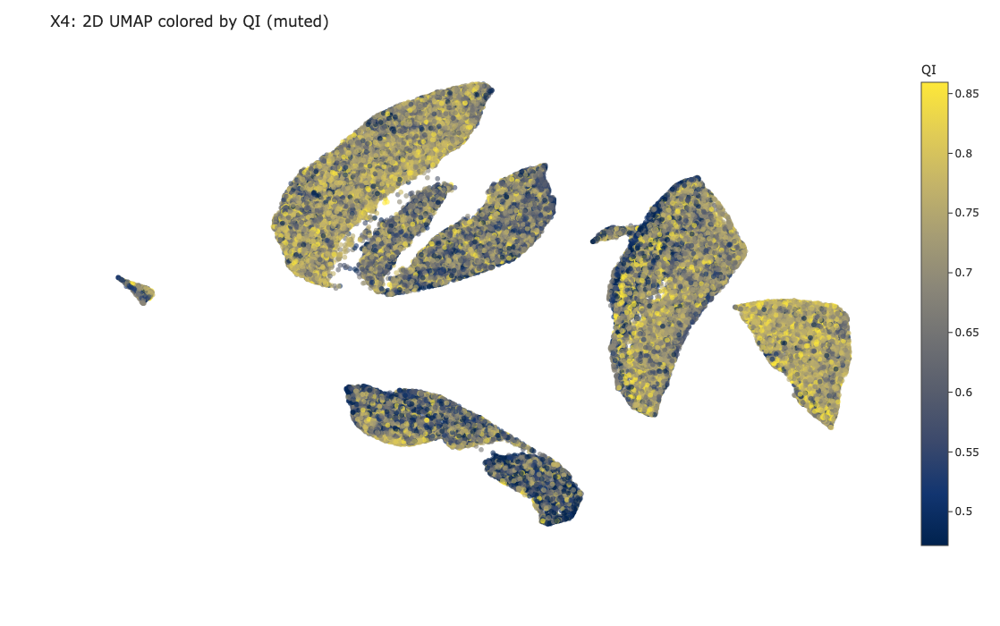

In [25]:
  import numpy as np
  import pandas as pd
  import plotly.express as px

  coords = np.asarray(X4_umap_2d)
  labels = np.asarray(X4_labels)

  df_plot = pd.DataFrame({
      "UMAP1": coords[:, 0],
      "UMAP2": coords[:, 1],
      "cluster": labels,
      "inc_key": X4["inc_key"].values
  })
  df_plot = df_plot.merge(X4_qi[["inc_key", QI_COL]], on="inc_key", how="left")
  df_plot = df_plot.dropna(subset=[QI_COL])

  # clip extremes so colors are calmer
  q05, q95 = df_plot[QI_COL].quantile([0.05, 0.95])

  fig = px.scatter(
      df_plot,
      x="UMAP1",
      y="UMAP2",
      color=QI_COL,
      color_continuous_scale="Cividis",
      range_color=(q05, q95),
      opacity=0.6,
      hover_data={"inc_key": True, "cluster": True, QI_COL: ':.3f'},
      width=900,
      height=700
  )

  fig.update_layout(
      title="X4: 2D UMAP colored by QI (muted)",
      xaxis_showgrid=False,
      yaxis_showgrid=False,
      xaxis_visible=False,
      yaxis_visible=False,
      template="simple_white"
  )

  fig.write_html("umap_qi_2d_muted.html")
  fig.show()

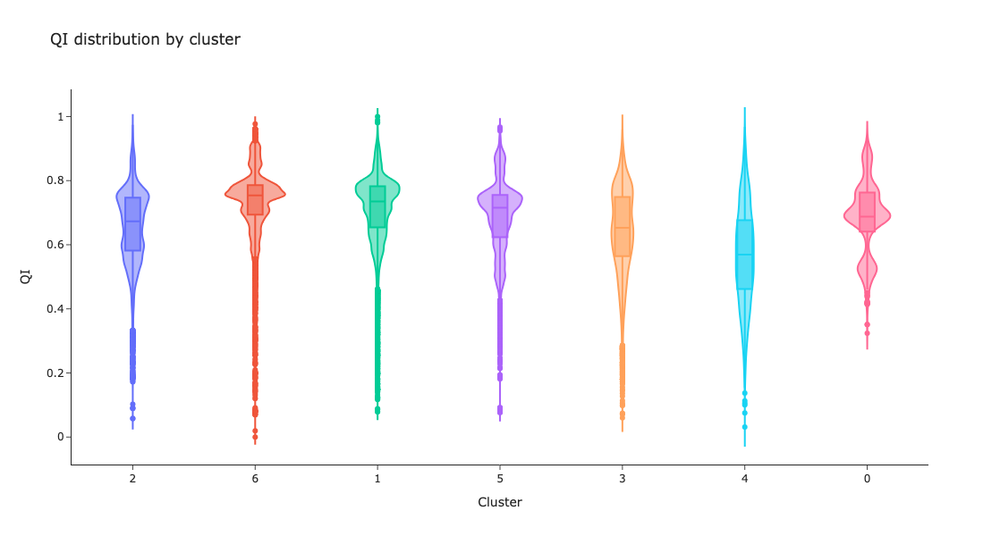

In [26]:
  import plotly.express as px

  # Optionally drop noise cluster
  df_vio = df_plot[df_plot["cluster"] != -1].copy()
  df_vio["cluster_str"] = df_vio["cluster"].astype(str)

  fig = px.violin(
      df_vio,
      x="cluster_str",
      y=QI_COL,
      color="cluster_str",
      box=True,
      points="outliers",
      title="QI distribution by cluster"
  )

  fig.update_layout(
      xaxis_title="Cluster",
      yaxis_title="QI",
      template="simple_white",
      showlegend=False,
      width=1000,
      height=600
  )

  fig.write_html("qi_by_cluster_violin.html")
  fig.show()

In [ ]:
  import plotly.express as px

  # Optionally drop noise cluster
  df_vio = df_plot[df_plot["cluster"] != -1].copy()
  df_vio["cluster_str"] = df_vio["cluster"].astype(str)

  fig = px.violin(
      df_vio,
      x="cluster_str",
      y=QI_COL,
      color="cluster_str",
      box=True,
      points="outliers",
      title="QI distribution by cluster"
  )

  fig.update_layout(
      xaxis_title="Cluster",
      yaxis_title="QI",
      template="simple_white",
      showlegend=False,
      width=1000,
      height=600
  )

  fig.write_html("qi_by_cluster_violin.html")
  fig.show()

In [53]:
import numpy as np
import pandas as pd

def infer_numeric_cat(df, exclude_cols=None, sample_size=500):
    """
    Automatically infer which columns are numeric vs categorical.

    Rules:
    - If the column dtype is numeric (int/float), mark as numeric.
    - If the dtype is not numeric, sample some values:
        * If >95% of sampled non-null values can be cast to float -> numeric
        * Otherwise -> categorical
    `exclude_cols` are ignored (e.g., IDs like inc_key).
    """
    if exclude_cols is None:
        exclude_cols = []

    numeric_cols = []
    cat_cols = []

    for col in df.columns:
        if col in exclude_cols:
            continue

        s = df[col]

        # 1) Explicit numeric dtype
        if pd.api.types.is_numeric_dtype(s):
            numeric_cols.append(col)
            continue

        # 2) Non-numeric dtype: try converting to float on a sample
        non_null = s.dropna().astype(str)
        if non_null.empty:
            # Column is all missing -> treat as categorical (or skip)
            cat_cols.append(col)
            continue

        # Sample up to sample_size rows
        sample = non_null.sample(
            n=min(sample_size, len(non_null)),
            random_state=0,
            replace=False
        )

        def is_float(x):
            try:
                float(x)
                return True
            except Exception:
                return False

        success_ratio = sample.map(is_float).mean()

        if success_ratio > 0.95:
            numeric_cols.append(col)
        else:
            cat_cols.append(col)

    return numeric_cols, cat_cols


# ==== Run the inference on X4 ====

# If you have ID-like columns that should NOT be treated as features, list them here.
EXCLUDE_COLS = ["inc_key", "patient_id"]
EXCLUDE_COLS = [c for c in EXCLUDE_COLS if c in X4.columns]

numeric_cols, cat_cols = infer_numeric_cat(X4, exclude_cols=EXCLUDE_COLS)

print("Inferred numeric_cols (numeric feature columns), count:", len(numeric_cols))
print(numeric_cols[:30])   # show first 30

print("\nInferred cat_cols (categorical/encoded feature columns), count:", len(cat_cols))
print(cat_cols)       # show first 30

Inferred numeric_cols (numeric feature columns), count: 1279
['fac_key', 'Intent2', 'MechanismType', 'hgt_fall', 'race', 'race_bin', 'ethnicity', 'sex', 'age', 'age_y', 'age_type', 'inj_year', 'county', 'ref_GCS', 'scene_prov', 'scene_HR', 'scene_RR', 'scene_SBP', 'scene_GCSe', 'scene_GCSv', 'scene_GCSm', 'scene_GCS', 'scene_intubated', 'eddispo', 'doa', 'blood_ml', 'plasm_ml', 'plate_ml', 'cryo_ml', 'prbc_vol']

Inferred cat_cols (categorical/encoded feature columns), count: 315
['e1_icd10', 'prbc_unit', 'rpd01_i10', 'rpd02_i10', 'rpd03_i10', 'rpd04_i10', 'rpd05_i10', 'rpd06_i10', 'rpd07_i10', 'rpd08_i10', 'rpd09_i10', 'rpd10_i10', 'rpd11_i10', 'rpd12_i10', 'rpt01_i10', 'rpt02_i10', 'rpt03_i10', 'rpt04_i10', 'rpt05_i10', 'rpt06_i10', 'rpt07_i10', 'rpt08_i10', 'rpt09_i10', 'rpt10_i10', 'rpt11_i10', 'rpt12_i10', 'compr_03', 'adm_serv_o', 'adm_srv_ns', 'icd10_01', 'predot_01', 'icd10_02', 'predot_02', 'icd10_03', 'predot_03', 'icd10_04', 'icd10_05', 'icd10_06', 'icd10_07', 'icd10_08', 'i

In [53]:
import numpy as np
import pandas as pd

# =====================================================
# Part 1 
# =====================================================
#X1_df = X1.reset_index(drop=True)
#X1_df = X2.reset_index(drop=True)  
X4_df = X4.reset_index(drop=True)  

labels = np.asarray(X4_labels)

assert len(X4_df) == len(labels), "X4_df row count and labels length do not match!"

# Remove noise (-1) from cluster set
unique_clusters = sorted(set(labels) - {-1})
print("Number of clusters (excluding -1):", len(unique_clusters))
print("Cluster IDs (first 20):", unique_clusters[:20])

# Make sure the numeric/categorical lists only include existing columns
numeric_cols_used = [c for c in numeric_cols if c in X4_df.columns]
cat_cols_used     = [c for c in cat_cols if c in X4_df.columns]

print("Numeric feature columns actually used:", len(numeric_cols_used))
print("Categorical feature columns actually used:", len(cat_cols_used))

Number of clusters (excluding -1): 7
Cluster IDs (first 20): [np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6)]
Numeric feature columns actually used: 1279
Categorical feature columns actually used: 315


In [54]:
# Global mean/std for numeric features (for baseline)
def find_elbow_k(values: pd.Series) -> int:
    vals = np.asarray(values.abs(), dtype=float)
    n = len(vals)
    if n == 0:
        return 0
    if n == 1:
        return 1

    # 相邻差值：前一个 - 后一个（因为是降序）
    drops = vals[:-1] - vals[1:]
    elbow_idx = np.argmax(drops)  # 掉得最多的那个位置
    k_elbow = elbow_idx + 1       # 取前 k_elbow 个

    return k_elbow
# =====================================================
# Part 2 — Numeric features with z-score + elbow
# 逻辑：
#   1) 先按 |z| 降序排序；
#   2) 用 find_elbow_k 找断崖位置 k_elbow_raw；
#   3) k_selected = max(k_elbow_raw, 15)，保证至少 15 个；
#   4) 如果 k_selected 覆盖了所有特征（说明没有明显断崖），
#      则改用 |z| >= 0.5 的特征；如果连 0.5 都没有，就退回前 15 个。
# =====================================================

MIN_CLUSTER_SIZE = 50  # too small clusters are skipped

# 全局均值 & 标准差（用于 z-score）
global_mean = X4_df[numeric_cols_used].mean()
global_std  = X4_df[numeric_cols_used].std().replace(0, 1.0)  # avoid division by zero

for k in unique_clusters:
    sub = X4_df[labels == k]
    n_k = len(sub)

    if n_k < MIN_CLUSTER_SIZE:
        print(f"\n=== Cluster {k} (n={n_k}) is too small; skipping numeric explanation for now. ===")
        continue

    print(f"\n================== Cluster {k} (n={n_k}) ==================")

    # Cluster-level means for numeric features
    mean_k = sub[numeric_cols_used].mean()

    # z-score: how far this cluster's mean is from global mean
    z = (mean_k - global_mean) / global_std
    z = z.reindex(numeric_cols_used)

    # 按 |z| 从大到小排序
    z_sorted = z.reindex(z.abs().sort_values(ascending=False).index)

    if z_sorted.empty:
        print("\n[Numeric] No valid features after z-score computation.")
        continue

    # 1) 先只根据“最大掉落”找到断崖位置（不加 15 限制）
    k_elbow_raw = find_elbow_k(z_sorted)

    # 2) 至少输出 15 个特征
    k_selected = max(k_elbow_raw, 15)

    # 3) 如果 k_selected 把所有特征都吃完了（== 全部长度），
    #    说明其实没什么明显断崖 → 改用 |z| >= 0.5 规则
    if k_selected >= 50:
        # 用绝对 z 值阈值 0.5
        selected = z_sorted[ z_sorted.abs() >= 0.5 ]

        if selected.empty:
            # 如果连 0.5 都没有，就退回“取前 15 个或所有”
            k_fallback = min(15, len(z_sorted))
            selected = z_sorted.iloc[:k_fallback]
            print(
                "\n[Numeric] No clear elbow and no |z| >= 0.5; "
                f"fall back to top {k_fallback} features by |z|."
            )
        else:
            print(
                "\n[Numeric] No clear elbow (k_selected covers nearly all features); "
                "using threshold |z| >= 0.5."
            )

    else:
        # 有明显断崖：用断崖位置（但已保证至少 15）
        selected = z_sorted.iloc[:k_selected]
        print(
            f"\n[Numeric] Using elbow-based selection: "
            f"k_elbow_raw={k_elbow_raw}, k_selected={k_selected} (min 15)."
        )

    # 最终打印选中的特征
    print(f"\n[Numeric features: selected {len(selected)} features]")
    for feat, zval in selected.items():
        direction = "higher than global" if zval > 0 else "lower than global"
        print(f"  {feat}: z = {zval:.2f} ({direction})")


================== Cluster 0 (n=964) ==================

[Numeric] No clear elbow (k_selected covers nearly all features); using threshold |z| >= 0.5.

[Numeric features: selected 112 features]
  comp_01_lc: z = 2.37 (higher than global)
  iss_reg_07: z = -2.24 (lower than global)
  ais_07: z = -2.19 (lower than global)
  edp07_sv: z = 2.10 (higher than global)
  mtrc92001: z = 2.00 (higher than global)
  eddispo: z = 1.74 (higher than global)
  ais_sev_07: z = -1.61 (lower than global)
  ais_05: z = -1.61 (lower than global)
  ais_reg_05: z = 1.54 (higher than global)
  complic_1: z = -1.54 (lower than global)
  ais_reg_06: z = 1.53 (higher than global)
  ais_06: z = -1.52 (lower than global)
  iss_reg_05: z = -1.52 (lower than global)
  predot_05: z = 1.47 (higher than global)
  predot_06: z = 1.46 (higher than global)
  inj_type: z = 1.45 (higher than global)
  ais_03: z = -1.44 (lower than global)
  scene_prov: z = 1.43 (higher than global)
  transport: z = 1.42 (higher than globa

In [ ]:
# =====================================================
# Part 3 — Categorical/text-like features with freq delta + elbow
# 逻辑：
#   1) 按 abs_delta 从大到小排序，用 find_elbow_k 找“断崖点”；
#   2) 选前 k_elbow_raw 个，如果 < 15，则至少取 15 个；
#   3) 最终输出前，按 delta 从大到小排序（更常见于该 cluster 的特征优先）。
# =====================================================

MISSING_TOKENS = {
    "na", "nan", "<n/a>", "<na>", "n/a",
    "", ".", "..", "none", "null"
}

def is_missing_like(v):
    """Return True if the value should be treated as missing/meaningless."""
    if pd.isna(v):
        return True
    if isinstance(v, str):
        s = v.strip()
        if s == "":
            return True
        if s.lower() in MISSING_TOKENS:
            return True
    return False

# Minimum cluster frequency threshold for a feature:value pair to be considered
MIN_CLUSTER_FREQ = 0.05  # value must appear in at least 5% of samples in that cluster

for k in unique_clusters:
    sub = X1_df[labels == k]
    n_k = len(sub)
    if n_k < MIN_CLUSTER_SIZE:
        continue  # consistent with numeric section

    print(f"\n=========== Cluster {k} (n={n_k}): Top feature:value pairs (categorical) ===========")

    rows = []

    for col in cat_cols_used:
        # 1) Global frequencies, filtering missing-like
        s_all = X1_df[col]
        s_all = s_all[~s_all.map(is_missing_like)]
        if s_all.empty:
            continue

        overall_freq = s_all.value_counts(normalize=True)

        # 2) Cluster frequencies, filtering missing-like
        s_clust = sub[col]
        s_clust = s_clust[~s_clust.map(is_missing_like)]
        if s_clust.empty:
            continue

        clust_freq = s_clust.value_counts(normalize=True)

        # 3) Union of all possible values
        index = clust_freq.index.union(overall_freq.index)

        for val in index:
            freq_c = clust_freq.get(val, 0.0)
            freq_g = overall_freq.get(val, 0.0)
            if freq_c == 0 and freq_g == 0:
                continue

            delta = freq_c - freq_g

            rows.append({
                "feature":      col,
                "value":        val,
                "cluster_freq": freq_c,
                "global_freq":  freq_g,
                "delta":        delta,
                "abs_delta":    abs(delta),
            })

    if not rows:
        print("  [Categorical] No valid non-missing values found.")
        continue

    df_cat = pd.DataFrame(rows)

    # Keep only feature:value pairs that are not too rare in this cluster
    df_cat = df_cat[df_cat["cluster_freq"] >= MIN_CLUSTER_FREQ]

    if df_cat.empty:
        print("  [Categorical] All values are too rare in this cluster (< MIN_CLUSTER_FREQ).")
        continue

    # 先按 abs_delta 从大到小排序，用于“断崖”检测
    df_cat_sorted_abs = df_cat.sort_values("abs_delta", ascending=False)

    # 使用当前的 find_elbow_k 在 abs_delta 上找“断崖点”
    abs_delta_series = df_cat_sorted_abs["abs_delta"]
    k_elbow_raw = find_elbow_k(abs_delta_series)

    if k_elbow_raw <= 0:
        # 如果 find_elbow_k 出了奇怪的结果，就至少取 15 行（或全量）
        k_selected = min(max(15, 1), len(df_cat_sorted_abs))
        print(
            f"\n[Categorical] Invalid elbow (k_elbow_raw={k_elbow_raw}); "
            f"fall back to at least {k_selected} rows."
        )
    else:
        # 正常情况：从断崖点开始，如果太少，则至少 15 行
        k_selected = max(k_elbow_raw, 15)
        k_selected = min(k_selected, len(df_cat_sorted_abs))
        print(
            f"\n[Categorical] Using elbow-based selection: "
            f"k_elbow_raw={k_elbow_raw}, k_selected={k_selected} (min 15)."
        )

    if k_selected == 0:
        print("  [Categorical] No distinctive values after selection.")
        continue

    # 先按 abs_delta 选前 k_selected 行
    selected = df_cat_sorted_abs.head(k_selected)

    # 最终输出时按 delta 从大到小排序：
    #   —— 更常见于该 cluster 的特征值（delta > 0）会排在前面
    selected_for_print = selected.sort_values("delta", ascending=False)

    print(f"\n[Categorical features: {len(selected_for_print)} feature:value pairs "
          f"(elbow + min 15, sorted by delta)]")
    for _, row in selected_for_print.iterrows():
        feat = row["feature"]
        val  = row["value"]
        f_c  = row["cluster_freq"]
        f_g  = row["global_freq"]
        d    = row["delta"]

        if d > 0:
            note = "much more common in this cluster"
        elif d < 0:
            note = "much less common in this cluster"
        else:
            note = "similar to global frequency"

        print(
            f"  {feat} = {repr(val)}: "
            f"cluster_freq={f_c:.3f}, global_freq={f_g:.3f}, delta={d:+.3f}  --> {note}"
        )

In [40]:
import numpy as np
import pandas as pd

def summarize_x1_to_x4_splits(x1_labels, x4_labels, noise_label=-1, ignore_noise=True):
    x1 = np.asarray(x1_labels).astype(int)
    x4 = np.asarray(x4_labels).astype(int)

    df = pd.DataFrame({"idx": np.arange(len(x1)), "x1": x1, "x4": x4})
    if ignore_noise:
        df = df[(df["x1"] != noise_label) & (df["x4"] != noise_label)].copy()

    # 每个 X1 cluster 的大小
    x1_size = df.groupby("x1").size().rename("x1_size")

    # 每个 X1 cluster 分到各个 X4 cluster 的人数
    pair = df.groupby(["x1", "x4"]).size().rename("count")

    # dominant X4
    dom_count = pair.groupby(level=0).max().rename("dom_count")
    dom_pair = pair.groupby(level=0).idxmax()
    dom_x4 = dom_pair.apply(lambda t: t[1]).rename("dom_x4")

    # 拆成几块（有多少个不同 X4）
    n_blocks = pair.groupby(level=0).size().rename("num_x4_blocks")

    summary = pd.concat([x1_size, dom_x4, dom_count, n_blocks], axis=1).dropna()
    summary["dom_frac"] = summary["dom_count"] / summary["x1_size"]
    summary = summary.sort_values("dom_frac", ascending=False)

    return summary, pair.reset_index()

# 用法（把 X4_labels 换上来！）
summary, pair_table = summarize_x1_to_x4_splits(X1_labels, X4_labels)

print(summary)

    x1_size  dom_x4  dom_count  num_x4_blocks  dom_frac
x1                                                     
2      2450       4       2450              1  1.000000
3       809       6        798              2  0.986403
4      8298       5       7324              4  0.882622
6      4433       2       3473              5  0.783442
1      4505       4       2736              2  0.607325
5     27682       5      16759              5  0.605411
7     33502       1      19474              5  0.581279
0     21683       3       9162              4  0.422543


In [38]:
import pandas as pd

pd.set_option("display.max_rows", None)
pd.set_option("display.max_columns", None)

print("x1 clusters in table:", list(count_table.index))
print("x4 clusters in table:", list(count_table.columns))
print("\n=== FULL COUNT TABLE ===")
print(count_table)

print("\n=== FULL PERCENT TABLE ===")
print(pct_table.round(2))

x1 clusters in table: [0, 1, 2, 3, 4, 5, 6, 7]
x4 clusters in table: [0, 1, 2, 3, 4, 5, 6]

=== FULL COUNT TABLE ===
x4    0      1      2     3     4      5      6
x1                                             
0     0   7558   4943  9162    20      0      0
1     0      0      0  1769  2736      0      0
2     0      0      0     0  2450      0      0
3     0      0      0     0     0     11    798
4   964      0      1     0     0   7324      9
5     0     14  10876     1     0  16759     32
6     0    107   3473     1     0     53    799
7     0  19474     36    10     0     26  13956

=== FULL PERCENT TABLE ===
x4      0      1      2      3       4      5      6
x1                                                  
0    0.00  34.86  22.80  42.25    0.09   0.00   0.00
1    0.00   0.00   0.00  39.27   60.73   0.00   0.00
2    0.00   0.00   0.00   0.00  100.00   0.00   0.00
3    0.00   0.00   0.00   0.00    0.00   1.36  98.64
4   11.62   0.00   0.01   0.00    0.00  88.26   0.11
5   

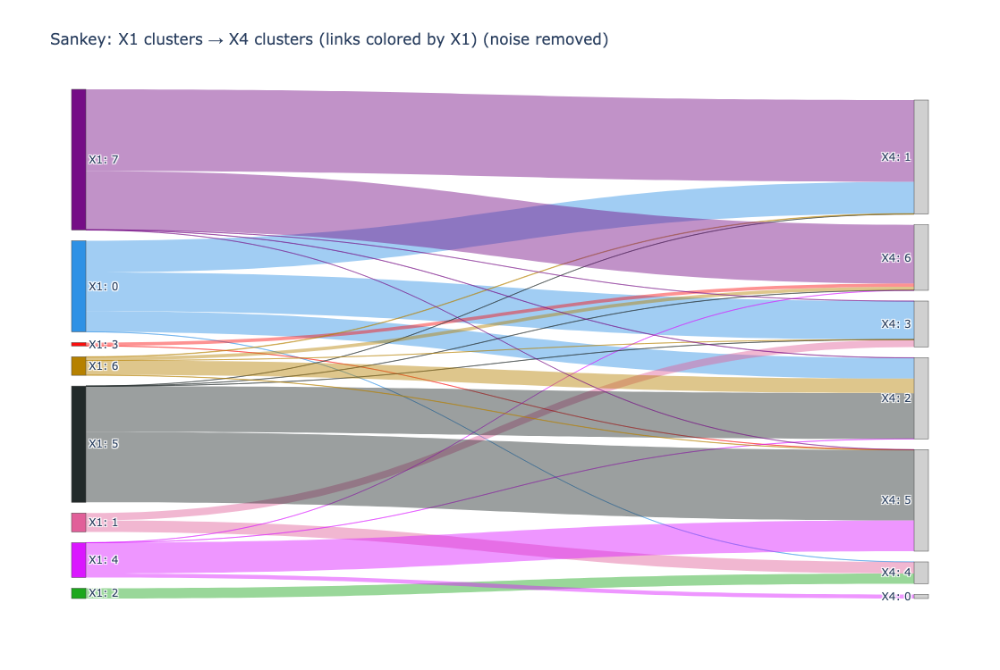

In [41]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px

def _hex_to_rgba(hex_color, alpha=0.45):
    hex_color = hex_color.lstrip("#")
    r = int(hex_color[0:2], 16)
    g = int(hex_color[2:4], 16)
    b = int(hex_color[4:6], 16)
    return f"rgba({r},{g},{b},{alpha})"

def sankey_x1_to_x4_colored(
    X1_labels,
    X4_labels,
    drop_noise=True,
    noise_label=-1,
    title="Sankey: X1 clusters → X4 clusters (links colored by X1)",
    width=1200,
    height=750
):
    x1 = np.asarray(X1_labels).astype(int)
    x4 = np.asarray(X4_labels).astype(int)
    if len(x1) != len(x4):
        raise ValueError(f"Length mismatch: X1={len(x1)} vs X4={len(x4)}")

    df = pd.DataFrame({"x1": x1, "x4": x4})

    if drop_noise:
        df = df[(df["x1"] != noise_label) & (df["x4"] != noise_label)].copy()

    # pair counts
    pair = df.groupby(["x1", "x4"]).size().reset_index(name="count")

    # totals per x1 for percentage
    x1_totals = df.groupby("x1").size().to_dict()
    pair["x1_total"] = pair["x1"].map(x1_totals)
    pair["pct_of_x1"] = pair["count"] / pair["x1_total"]

    # nodes
    x1_nodes = sorted(pair["x1"].unique().tolist())
    x4_nodes = sorted(pair["x4"].unique().tolist())

    x1_labels_str = [f"X1: {c}" for c in x1_nodes]
    x4_labels_str = [f"X4: {c}" for c in x4_nodes]
    node_labels = x1_labels_str + x4_labels_str

    x1_to_idx = {c: i for i, c in enumerate(x1_nodes)}
    x4_to_idx = {c: i + len(x1_nodes) for i, c in enumerate(x4_nodes)}

    sources = pair["x1"].map(x1_to_idx).to_numpy()
    targets = pair["x4"].map(x4_to_idx).to_numpy()
    values  = pair["count"].to_numpy()

    # Colors (consistent per X1)
    palette = px.colors.qualitative.Dark24  # lots of distinct colors
    x1_color_map = {c: palette[i % len(palette)] for i, c in enumerate(x1_nodes)}

    node_colors = (
        [x1_color_map[c] for c in x1_nodes] +
        ["#D0D0D0"] * len(x4_nodes)   # make X4 nodes neutral gray
    )

    link_colors = [_hex_to_rgba(x1_color_map[c], alpha=0.45) for c in pair["x1"]]

    # Hover: show counts + % of source X1 cluster
    # customdata columns: [pct, count, x1_total, x1, x4]
    customdata = np.stack([
        pair["pct_of_x1"].to_numpy(),
        pair["count"].to_numpy(),
        pair["x1_total"].to_numpy(),
        pair["x1"].to_numpy(),
        pair["x4"].to_numpy(),
    ], axis=1)

    fig = go.Figure(data=[go.Sankey(
        arrangement="snap",
        node=dict(
            pad=12,
            thickness=16,
            label=node_labels,
            color=node_colors,
            line=dict(width=0.5),
            hovertemplate="%{label}<extra></extra>",
        ),
        link=dict(
            source=sources,
            target=targets,
            value=values,
            color=link_colors,
            customdata=customdata,
            hovertemplate=(
                "X1 %{customdata[3]} \u2192 X4 %{customdata[4]}<br>"
                "Count: %{customdata[1]:,} / %{customdata[2]:,}<br>"
                "Percent of X1 %{customdata[3]}: %{customdata[0]:.2%}"
                "<extra></extra>"
            ),
        )
    )])

    fig.update_layout(title=title + ("" if not drop_noise else " (noise removed)"),
                      width=width, height=height)
    fig.show()


# ===== Usage =====
sankey_x1_to_x4_colored(X1_labels, X4_labels, drop_noise=True)

In [44]:
import os
import numpy as np
import pandas as pd

from sklearn.model_selection import train_test_split
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.tree import DecisionTreeClassifier, plot_tree, export_text
import matplotlib.pyplot as plt


# =========================
# 0) 你需要提供的输入
# =========================
# df_X1: DataFrame with inc_key
# X1_labels: array-like aligned with df_X1 rows
# df_X2: DataFrame with inc_key + X2 features
# df_X4: DataFrame with inc_key
# X4_labels: array-like aligned with df_X4 rows

# 例：如果你的变量名不同，改这里即可
df_X1 = X1
df_X2 = X2
df_X4 = X4
# X1_labels = X1_labels
# X4_labels = X4_labels


# =========================
# 1) 基于 inc_key 做对齐
# =========================
def build_aligned_table(df_X1, X1_labels, df_X2, df_X4, X4_labels):
    df1 = df_X1[["inc_key"]].copy()
    df1["x1_cluster"] = np.asarray(X1_labels).astype(int)

    df4 = df_X4[["inc_key"]].copy()
    df4["x4_cluster"] = np.asarray(X4_labels).astype(int)

    # 检查 inc_key 是否唯一（如果不唯一，需要你先聚合/去重）
    if df1["inc_key"].duplicated().any():
        raise ValueError("df_X1 has duplicated inc_key. Please deduplicate/aggregate first.")
    if df4["inc_key"].duplicated().any():
        raise ValueError("df_X4 has duplicated inc_key. Please deduplicate/aggregate first.")
    if df_X2["inc_key"].duplicated().any():
        # X2 也建议一人一行；如果不是，需要你先处理
        raise ValueError("df_X2 has duplicated inc_key. Please deduplicate/aggregate first.")

    # 只保留三方都有的病人
    aligned = df1.merge(df_X2, on="inc_key", how="inner").merge(df4, on="inc_key", how="inner")
    return aligned


# =========================
# 2) 针对每个 X1 cluster 训练 CART 并输出树图
# =========================
def run_cart_per_x1_cluster(
    aligned_df: pd.DataFrame,
    output_dir: str = "./cart_trees",
    max_depth: int = 5,
    include_noise: bool = False,          # 是否包含 -1（HDBSCAN noise）
    min_class_count: int = 5,             # 一个 X4 类别少于此数时可选择丢弃（避免树乱学）
    min_samples_leaf: int = 20,           # 叶子最少样本（抑制过拟合；你可改）
    test_size: float = 0.2,
    random_state: int = 42,
):
    os.makedirs(output_dir, exist_ok=True)

    df = aligned_df.copy()

    if not include_noise:
        df = df[(df["x1_cluster"] != -1) & (df["x4_cluster"] != -1)].copy()

    # X2 特征列：除了 inc_key、x1_cluster、x4_cluster 以外的全是特征
    feature_cols = [c for c in df.columns if c not in ["inc_key", "x1_cluster", "x4_cluster"]]

    # 划分数值/类别列（object/category 走 one-hot）
    X2_feat = df[feature_cols]
    cat_cols = X2_feat.select_dtypes(include=["object", "category"]).columns.tolist()
    num_cols = [c for c in feature_cols if c not in cat_cols]

    # 预处理：数值填中位数；类别填缺失+one-hot（可用 min_frequency 合并稀有类）
    preprocessor = ColumnTransformer(
        transformers=[
            ("num", Pipeline(steps=[
                ("imputer", SimpleImputer(strategy="median")),
            ]), num_cols),
            ("cat", Pipeline(steps=[
                ("imputer", SimpleImputer(strategy="most_frequent")),
                ("onehot", OneHotEncoder(handle_unknown="ignore", min_frequency=10)),
            ]), cat_cols),
        ],
        remainder="drop",
        sparse_threshold=0.3
    )

    # 每个 X1 cluster 单独训练
    clusters = sorted(df["x1_cluster"].unique().tolist())
    results = []

    for c in clusters:
        sub = df[df["x1_cluster"] == c].copy()
        y = sub["x4_cluster"].astype(int)

        # 如果这个 X1 cluster 在 X4 中根本没分裂（只有一个类），就跳过
        if y.nunique() < 2:
            results.append((c, len(sub), y.nunique(), "SKIP (no split)"))
            continue

        # 可选：丢掉极小类（你若想“强行保留20个异常类”，就把 min_class_count 设成 1）
        vc = y.value_counts()
        keep = vc[vc >= min_class_count].index
        sub = sub[y.isin(keep)].copy()
        y = sub["x4_cluster"].astype(int)

        if y.nunique() < 2:
            results.append((c, len(sub), y.nunique(), f"SKIP (after filtering <{min_class_count})"))
            continue

        X = sub[feature_cols]

        # train/test split（分层）
        X_train, X_test, y_train, y_test = train_test_split(
            X, y,
            test_size=test_size,
            random_state=random_state,
            stratify=y
        )

        clf = DecisionTreeClassifier(
            max_depth=max_depth,
            min_samples_leaf=min_samples_leaf,
            class_weight="balanced",   # 强不平衡时更稳
            random_state=random_state
        )

        pipe = Pipeline(steps=[
            ("prep", preprocessor),
            ("cart", clf)
        ])

        pipe.fit(X_train, y_train)

        # 取出训练后的树
        cart = pipe.named_steps["cart"]

        # 输出树的文本规则（可选：更便于复制到报告）
        try:
            # 获取经过 one-hot 后的特征名
            feat_names = pipe.named_steps["prep"].get_feature_names_out()
            tree_text = export_text(cart, feature_names=list(feat_names), max_depth=max_depth)
            with open(os.path.join(output_dir, f"cart_x1cluster_{c}_depth{max_depth}.txt"), "w") as f:
                f.write(tree_text)
        except Exception as e:
            print(f"[Warn] Could not export text for cluster {c}: {e}")

        # 输出树图
        plt.figure(figsize=(24, 10))
        plot_tree(
            cart,
            feature_names=None,      # 特征多时不写名更清楚；想写名可改成 list(feat_names)
            class_names=[str(k) for k in sorted(y.unique())],
            filled=True,
            rounded=True,
            impurity=True,
            fontsize=8
        )
        plt.title(f"CART for X1 cluster {c} → predict X4 cluster (max_depth={max_depth})\nN={len(sub)} | X4 classes={sorted(y.unique())}")
        out_png = os.path.join(output_dir, f"cart_x1cluster_{c}_depth{max_depth}.png")
        plt.tight_layout()
        plt.savefig(out_png, dpi=200)
        plt.close()

        results.append((c, len(sub), y.nunique(), f"OK → {out_png}"))

    return pd.DataFrame(results, columns=["x1_cluster", "n_samples_used", "num_x4_classes", "status"])


# =========================
# 3) 一键运行
# =========================
aligned = build_aligned_table(df_X1, X1_labels, df_X2, df_X4, X4_labels)

# 关键：如果你想保留“20个异常类”，把 min_class_count 设成 1（不丢任何类）
summary = run_cart_per_x1_cluster(
    aligned_df=aligned,
    output_dir="./cart_trees_depth5",
    max_depth=5,
    include_noise=False,
    min_class_count=2,     # 保留所有类，包括很小的 20 人那类
    min_samples_leaf=10,   # 小类要想让树能分出来，leaf不要设太大（但也别太小）
)

print(summary)

   x1_cluster  n_samples_used  num_x4_classes  \
0           0           21683               4   
1           1            4505               2   
2           2            2450               1   
3           3             809               2   
4           4            8297               3   
5           5           27681               4   
6           6            4432               4   
7           7           33502               5   

                                              status  
0  OK → ./cart_trees_depth5/cart_x1cluster_0_dept...  
1  OK → ./cart_trees_depth5/cart_x1cluster_1_dept...  
2                                    SKIP (no split)  
3  OK → ./cart_trees_depth5/cart_x1cluster_3_dept...  
4  OK → ./cart_trees_depth5/cart_x1cluster_4_dept...  
5  OK → ./cart_trees_depth5/cart_x1cluster_5_dept...  
6  OK → ./cart_trees_depth5/cart_x1cluster_6_dept...  
7  OK → ./cart_trees_depth5/cart_x1cluster_7_dept...  


In [46]:
import os
import numpy as np
import pandas as pd

from sklearn.model_selection import train_test_split
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.tree import DecisionTreeClassifier, plot_tree, export_text
from sklearn.metrics import accuracy_score

import matplotlib.pyplot as plt


def run_cart_per_x1_cluster_with_metrics(
    aligned_df: pd.DataFrame,
    output_dir: str = "./cart_trees_depth5",
    max_depth: int = 5,
    include_noise: bool = False,
    noise_label: int = -1,
    min_class_count: int = 1,          # keep tiny classes (e.g., 20) if >=1
    min_samples_leaf: int = 10,
    test_size: float = 0.2,
    random_state: int = 42,
    skip_x1_clusters=None,             # e.g., [2]
):
    os.makedirs(output_dir, exist_ok=True)

    df = aligned_df.copy()
    if not include_noise:
        df = df[(df["x1_cluster"] != noise_label) & (df["x4_cluster"] != noise_label)].copy()

    if skip_x1_clusters is None:
        skip_x1_clusters = set()
    else:
        skip_x1_clusters = set(skip_x1_clusters)

    # X2 features = all columns except identifiers/labels
    feature_cols = [c for c in df.columns if c not in ["inc_key", "x1_cluster", "x4_cluster"]]
    X2_feat = df[feature_cols]

    # numeric vs categorical
    cat_cols = X2_feat.select_dtypes(include=["object", "category"]).columns.tolist()
    num_cols = [c for c in feature_cols if c not in cat_cols]

    # preprocess: impute + onehot for categoricals
    preprocessor = ColumnTransformer(
        transformers=[
            ("num", Pipeline(steps=[
                ("imputer", SimpleImputer(strategy="median")),
            ]), num_cols),
            ("cat", Pipeline(steps=[
                ("imputer", SimpleImputer(strategy="most_frequent")),
                ("onehot", OneHotEncoder(handle_unknown="ignore", min_frequency=10)),
            ]), cat_cols),
        ],
        remainder="drop",
        sparse_threshold=0.3
    )

    clusters = sorted(df["x1_cluster"].unique().tolist())
    rows = []

    for c in clusters:
        if c in skip_x1_clusters:
            rows.append({
                "x1_cluster": c,
                "n_samples_used": 0,
                "num_x4_classes": 0,
                "y_counts": "",
                "split_note": "SKIP (manually excluded)",
                "train_acc": np.nan,
                "test_acc": np.nan,
                "tree_png": "",
                "tree_txt": ""
            })
            continue

        sub = df[df["x1_cluster"] == c].copy()
        y = sub["x4_cluster"].astype(int)

        # skip if no split
        if y.nunique() < 2:
            rows.append({
                "x1_cluster": c,
                "n_samples_used": int(len(sub)),
                "num_x4_classes": int(y.nunique()),
                "y_counts": y.value_counts().to_dict(),
                "split_note": "SKIP (no split)",
                "train_acc": np.nan,
                "test_acc": np.nan,
                "tree_png": "",
                "tree_txt": ""
            })
            continue

        # Keep classes with count >= min_class_count
        vc = y.value_counts()
        keep = vc[vc >= min_class_count].index
        sub = sub[y.isin(keep)].copy()
        y = sub["x4_cluster"].astype(int)
        vc = y.value_counts()

        if y.nunique() < 2:
            rows.append({
                "x1_cluster": c,
                "n_samples_used": int(len(sub)),
                "num_x4_classes": int(y.nunique()),
                "y_counts": vc.to_dict(),
                "split_note": f"SKIP (after filtering <{min_class_count})",
                "train_acc": np.nan,
                "test_acc": np.nan,
                "tree_png": "",
                "tree_txt": ""
            })
            continue

        X = sub[feature_cols]

        # Decide split strategy:
        # stratify requires every class count >= 2
        if vc.min() < 2:
            # can't stratify; fit on all data for interpretation
            X_train, y_train = X, y
            X_test, y_test = None, None
            split_note = f"NO SPLIT (singleton class exists: {vc[vc<2].to_dict()})"
        else:
            X_train, X_test, y_train, y_test = train_test_split(
                X, y,
                test_size=test_size,
                random_state=random_state,
                stratify=y
            )
            split_note = f"train/test split (test_size={test_size})"

        clf = DecisionTreeClassifier(
            max_depth=max_depth,
            min_samples_leaf=min_samples_leaf,
            class_weight="balanced",
            random_state=random_state
        )

        pipe = Pipeline(steps=[
            ("prep", preprocessor),
            ("cart", clf)
        ])

        pipe.fit(X_train, y_train)

        # accuracies
        yhat_train = pipe.predict(X_train)
        train_acc = accuracy_score(y_train, yhat_train)

        if X_test is not None:
            yhat_test = pipe.predict(X_test)
            test_acc = accuracy_score(y_test, yhat_test)
        else:
            test_acc = np.nan

        # Export tree text
        tree_txt_path = os.path.join(output_dir, f"cart_x1cluster_{c}_depth{max_depth}.txt")
        try:
            feat_names = pipe.named_steps["prep"].get_feature_names_out()
            cart = pipe.named_steps["cart"]
            tree_text = export_text(cart, feature_names=list(feat_names), max_depth=max_depth)
            with open(tree_txt_path, "w") as f:
                f.write(tree_text)
        except Exception as e:
            tree_txt_path = ""
            print(f"[Warn] Could not export text for cluster {c}: {e}")

        # Export tree plot
        tree_png_path = os.path.join(output_dir, f"cart_x1cluster_{c}_depth{max_depth}.png")
        try:
            cart = pipe.named_steps["cart"]
            plt.figure(figsize=(24, 10))
            plot_tree(
                cart,
                feature_names=None,  # set to list(feat_names) if you REALLY want names (can get unreadable)
                class_names=[str(k) for k in sorted(y.unique())],
                filled=True,
                rounded=True,
                impurity=True,
                fontsize=8
            )
            plt.title(
                f"CART for X1 cluster {c} → predict X4 cluster (max_depth={max_depth})\n"
                f"N={len(sub)} | y classes={sorted(y.unique())} | train_acc={train_acc:.3f}"
                + ("" if np.isnan(test_acc) else f" | test_acc={test_acc:.3f}")
            )
            plt.tight_layout()
            plt.savefig(tree_png_path, dpi=200)
            plt.close()
        except Exception as e:
            tree_png_path = ""
            print(f"[Warn] Could not export plot for cluster {c}: {e}")

        rows.append({
            "x1_cluster": c,
            "n_samples_used": int(len(sub)),
            "num_x4_classes": int(y.nunique()),
            "y_counts": vc.to_dict(),
            "split_note": split_note,
            "train_acc": float(train_acc),
            "test_acc": (float(test_acc) if X_test is not None else np.nan),
            "tree_png": tree_png_path,
            "tree_txt": tree_txt_path
        })

    summary_df = pd.DataFrame(rows).sort_values("x1_cluster")
    return summary_df


# ===== Usage =====
# aligned is the merged table you already built with:
# columns: inc_key, x1_cluster, x4_cluster, (X2 features...)
summary_df = run_cart_per_x1_cluster_with_metrics(
    aligned_df=aligned,
    output_dir="./cart_trees_depth5",
    max_depth=8,
    include_noise=False,
    min_class_count=2,      # keep small classes like the 20-patient group
    min_samples_leaf=10,
    test_size=0.2,
    skip_x1_clusters=[2],   # optional; it would be skipped anyway due to no split
)

print(summary_df[["x1_cluster", "n_samples_used", "num_x4_classes", "y_counts", "split_note", "train_acc", "test_acc", "tree_png"]])


   x1_cluster  n_samples_used  num_x4_classes  \
0           0           21683               4   
1           1            4505               2   
2           2               0               0   
3           3             809               2   
4           4            8297               3   
5           5           27681               4   
6           6            4432               4   
7           7           33502               5   

                                    y_counts  \
0         {3: 9162, 1: 7558, 2: 4943, 4: 20}   
1                         {4: 2736, 3: 1769}   
2                                              
3                            {6: 798, 5: 11}   
4                    {5: 7324, 0: 964, 6: 9}   
5         {5: 16759, 2: 10876, 6: 32, 1: 14}   
6           {2: 3473, 6: 799, 1: 107, 5: 53}   
7  {1: 19474, 6: 13956, 2: 36, 5: 26, 3: 10}   

                         split_note  train_acc  test_acc  \
0  train/test split (test_size=0.2)   0.562089  0.557528   
1  tr

In [49]:
import os
import re
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.tree import DecisionTreeClassifier, plot_tree, export_text
from sklearn.metrics import accuracy_score


# ============================================================
# 1) Load mapping: Metric ID (numeric) -> Description (string)
#    Only use columns: "Metric ID" and "Description"
# ============================================================
def load_metric_id_to_desc(
    xlsx_path="/Users/jingyi/Desktop/Trauma_LLM/metric_def.xlsx",
    metric_id_col="Metric ID",
    desc_col="Description",
    sheet_name=0,  # use first sheet by default; change if needed
):
    if not os.path.exists(xlsx_path):
        raise FileNotFoundError(f"Excel not found: {xlsx_path}")

    df = pd.read_excel(xlsx_path, sheet_name=sheet_name)

    if metric_id_col not in df.columns or desc_col not in df.columns:
        raise ValueError(
            f"Cannot find required columns in Excel. "
            f"Need '{metric_id_col}' and '{desc_col}'. "
            f"Got columns: {list(df.columns)}"
        )

    ids = pd.to_numeric(df[metric_id_col], errors="coerce")
    desc = df[desc_col].astype(str)

    keep = ids.notna() & desc.notna() & (desc.str.strip() != "")
    ids = ids[keep].astype(int)
    desc = desc[keep].str.strip()

    id2desc = {}
    for i, d in zip(ids, desc):
        if i not in id2desc:
            id2desc[i] = d

    if not id2desc:
        raise ValueError("Built empty id2desc mapping. Check the Excel content in 'Metric ID' and 'Description'.")

    print(f"[metric_def] Loaded {len(id2desc)} metric definitions from '{xlsx_path}' (sheet={sheet_name}).")
    return id2desc


# ============================================================
# 2) Rename mtrc columns in your aligned_df using id2desc
#    mtrcX -> "mtrc_XX - Description"
# ============================================================
def rename_mtrc_columns_using_desc(
    df: pd.DataFrame,
    id2desc: dict,
    pad=2,                 # mtrc_03 style
    max_desc_len=80,       # shorten description on plots
):
    renamed = {}
    for col in df.columns:
        c = str(col).strip()
        low = c.lower().replace(" ", "").replace("-", "_")

        # match mtrc patterns like: mtrc3 / mtrc_3 / mtrc03 / mtrc_03
        m = re.match(r"^mtrc_?(\d+)$", low)
        if not m:
            continue

        mid = int(m.group(1))
        if mid not in id2desc:
            continue

        desc = str(id2desc[mid]).strip()
        if len(desc) > max_desc_len:
            desc = desc[: max_desc_len - 3] + "..."

        new_name = f"mtrc_{mid:0{pad}d} - {desc}"
        renamed[col] = new_name

    df2 = df.rename(columns=renamed)
    return df2, renamed


# Optional: clean long feature names after one-hot encoding so the tree is readable
def clean_feature_name(s: str, max_len=70):
    s = str(s)
    # remove sklearn prefixes like "num__" / "cat__"
    s = re.sub(r"^(num__|cat__)", "", s)
    # compress multiple underscores
    s = re.sub(r"__+", "_", s)
    return s if len(s) <= max_len else (s[: max_len - 3] + "...")


# ============================================================
# 3) CART per X1 cluster with train/test acc + tree plot (named)
# ============================================================
def run_cart_per_x1_cluster_named(
    aligned_df: pd.DataFrame,
    output_dir: str = "./cart_trees_depth5_named",
    max_depth: int = 5,
    include_noise: bool = False,
    noise_label: int = -1,
    min_class_count: int = 1,      # keep rare classes (e.g., 20) if you want
    min_samples_leaf: int = 10,
    test_size: float = 0.2,
    random_state: int = 42,
    skip_x1_clusters=None,         # e.g., [2]
    plot_name_max_len: int = 70,
):
    os.makedirs(output_dir, exist_ok=True)

    df = aligned_df.copy()

    # optional: remove noise points
    if not include_noise:
        df = df[(df["x1_cluster"] != noise_label) & (df["x4_cluster"] != noise_label)].copy()

    if skip_x1_clusters is None:
        skip_x1_clusters = set()
    else:
        skip_x1_clusters = set(skip_x1_clusters)

    # feature columns = everything except IDs/labels
    feature_cols = [c for c in df.columns if c not in ["inc_key", "x1_cluster", "x4_cluster"]]
    X_feat = df[feature_cols]

    # detect categorical columns
    cat_cols = X_feat.select_dtypes(include=["object", "category"]).columns.tolist()
    num_cols = [c for c in feature_cols if c not in cat_cols]

    # preprocess
    preprocessor = ColumnTransformer(
        transformers=[
            ("num", Pipeline(steps=[("imputer", SimpleImputer(strategy="median"))]), num_cols),
            ("cat", Pipeline(steps=[
                ("imputer", SimpleImputer(strategy="most_frequent")),
                ("onehot", OneHotEncoder(handle_unknown="ignore", min_frequency=10)),
            ]), cat_cols),
        ],
        remainder="drop",
        sparse_threshold=0.3
    )

    results = []
    clusters = sorted(df["x1_cluster"].unique().tolist())

    for c in clusters:
        if c in skip_x1_clusters:
            results.append({
                "x1_cluster": c,
                "n_samples_used": 0,
                "num_x4_classes": 0,
                "y_counts": "",
                "split_note": "SKIP (manually excluded)",
                "train_acc": np.nan,
                "test_acc": np.nan,
                "tree_png": "",
                "tree_txt": ""
            })
            continue

        sub = df[df["x1_cluster"] == c].copy()
        y = sub["x4_cluster"].astype(int)

        # if no split, skip
        if y.nunique() < 2:
            results.append({
                "x1_cluster": c,
                "n_samples_used": int(len(sub)),
                "num_x4_classes": int(y.nunique()),
                "y_counts": y.value_counts().to_dict(),
                "split_note": "SKIP (no split)",
                "train_acc": np.nan,
                "test_acc": np.nan,
                "tree_png": "",
                "tree_txt": ""
            })
            continue

        # keep classes >= min_class_count
        vc = y.value_counts()
        keep_classes = vc[vc >= min_class_count].index
        sub = sub[y.isin(keep_classes)].copy()
        y = sub["x4_cluster"].astype(int)
        vc = y.value_counts()

        if y.nunique() < 2:
            results.append({
                "x1_cluster": c,
                "n_samples_used": int(len(sub)),
                "num_x4_classes": int(y.nunique()),
                "y_counts": vc.to_dict(),
                "split_note": f"SKIP (after filtering <{min_class_count})",
                "train_acc": np.nan,
                "test_acc": np.nan,
                "tree_png": "",
                "tree_txt": ""
            })
            continue

        X = sub[feature_cols]

        # stratify split requires each class count >= 2
        if vc.min() < 2:
            X_train, y_train = X, y
            X_test, y_test = None, None
            split_note = f"NO SPLIT (singleton class exists: {vc[vc<2].to_dict()})"
        else:
            X_train, X_test, y_train, y_test = train_test_split(
                X, y,
                test_size=test_size,
                random_state=random_state,
                stratify=y
            )
            split_note = f"train/test split (test_size={test_size})"

        # CART
        clf = DecisionTreeClassifier(
            max_depth=max_depth,
            min_samples_leaf=min_samples_leaf,
            class_weight="balanced",
            random_state=random_state
        )

        pipe = Pipeline(steps=[("prep", preprocessor), ("cart", clf)])
        pipe.fit(X_train, y_train)

        # accuracy
        train_acc = accuracy_score(y_train, pipe.predict(X_train))
        test_acc = accuracy_score(y_test, pipe.predict(X_test)) if X_test is not None else np.nan

        # feature names after preprocessing
        feat_names = pipe.named_steps["prep"].get_feature_names_out()
        feat_names = [clean_feature_name(n, max_len=plot_name_max_len) for n in feat_names]

        # export tree text
        tree_txt_path = os.path.join(output_dir, f"cart_x1cluster_{c}_depth{max_depth}.txt")
        try:
            cart = pipe.named_steps["cart"]
            txt = export_text(cart, feature_names=list(feat_names), max_depth=max_depth)
            with open(tree_txt_path, "w") as f:
                f.write(txt)
        except Exception as e:
            print(f"[Warn] export_text failed for cluster {c}: {e}")
            tree_txt_path = ""

        # export tree plot
        tree_png_path = os.path.join(output_dir, f"cart_x1cluster_{c}_depth{max_depth}.png")
        try:
            cart = pipe.named_steps["cart"]
            plt.figure(figsize=(28, 12))
            plot_tree(
                cart,
                feature_names=list(feat_names),     # <-- this is the definition-substituted names
                class_names=[str(k) for k in sorted(y.unique())],
                filled=True,
                rounded=True,
                impurity=True,
                fontsize=7
            )
            plt.title(
                f"CART (depth={max_depth}) | X1 cluster {c} → X4 cluster\n"
                f"N={len(sub)} | y_counts={vc.to_dict()} | train_acc={train_acc:.3f}"
                + ("" if np.isnan(test_acc) else f" | test_acc={test_acc:.3f}")
            )
            plt.tight_layout()
            plt.savefig(tree_png_path, dpi=200)
            plt.close()
        except Exception as e:
            print(f"[Warn] plot_tree failed for cluster {c}: {e}")
            tree_png_path = ""

        results.append({
            "x1_cluster": c,
            "n_samples_used": int(len(sub)),
            "num_x4_classes": int(y.nunique()),
            "y_counts": vc.to_dict(),
            "split_note": split_note,
            "train_acc": float(train_acc),
            "test_acc": (float(test_acc) if X_test is not None else np.nan),
            "tree_png": tree_png_path,
            "tree_txt": tree_txt_path
        })

    summary_df = pd.DataFrame(results).sort_values("x1_cluster")
    summary_path = os.path.join(output_dir, "cart_summary.csv")
    summary_df.to_csv(summary_path, index=False)
    print(f"[Saved] summary table -> {summary_path}")
    return summary_df


# ============================================================
# 4) ONE-CLICK RUN (you only need to provide `aligned`)
#    aligned must contain:
#      inc_key, x1_cluster, x4_cluster, and X2 feature columns including mtrc*
# ============================================================
# Step 1: load mapping from Excel
id2desc = load_metric_id_to_desc(
    xlsx_path="/Users/jingyi/Desktop/Trauma_LLM/metric_def.xlsx",
    metric_id_col="Metric ID",
    desc_col="Description",
    sheet_name=0
)

# Step 2: rename mtrc columns in aligned
aligned_named, rename_dict = rename_mtrc_columns_using_desc(
    aligned, id2desc,
    pad=2,
    max_desc_len=80
)

# save rename log for traceability
out_dir = "./cart_trees_depth5_named"
os.makedirs(out_dir, exist_ok=True)
pd.DataFrame([{"original": k, "renamed": v} for k, v in rename_dict.items()]).to_csv(
    os.path.join(out_dir, "mtrc_rename_log.csv"), index=False
)
print(f"[Saved] rename log -> {os.path.join(out_dir, 'mtrc_rename_log.csv')}")
print("Renamed mtrc columns:", len(rename_dict))

# Step 3: run CART per X1 cluster (skip cluster 2)
summary_df = run_cart_per_x1_cluster_named(
    aligned_df=aligned_named,
    output_dir=out_dir,
    max_depth=5,
    min_class_count=2,     # keep your 20-patient rare class
    min_samples_leaf=10,
    skip_x1_clusters=[2],  # you asked to drop x1 cluster 2
    plot_name_max_len=70
)

print(summary_df[["x1_cluster", "split_note", "train_acc", "test_acc", "tree_png"]])

[metric_def] Loaded 128 metric definitions from '/Users/jingyi/Desktop/Trauma_LLM/metric_def.xlsx' (sheet=0).
[Saved] rename log -> ./cart_trees_depth5_named/mtrc_rename_log.csv
Renamed mtrc columns: 115
[Saved] summary table -> ./cart_trees_depth5_named/cart_summary.csv
   x1_cluster                        split_note  train_acc  test_acc  \
0           0  train/test split (test_size=0.2)   0.534302  0.528245   
1           1  train/test split (test_size=0.2)   0.673418  0.649279   
2           2          SKIP (manually excluded)        NaN       NaN   
3           3  train/test split (test_size=0.2)   0.721793  0.746914   
4           4  train/test split (test_size=0.2)   0.700768  0.717470   
5           5  train/test split (test_size=0.2)   0.634980  0.630305   
6           6  train/test split (test_size=0.2)   0.333145  0.320180   
7           7  train/test split (test_size=0.2)   0.533973  0.541113   

                                            tree_png  
0  ./cart_trees_depth5_n

In [51]:
X1.dtypes

fac_key                                     int32
inc_key                                     int32
e1_icd10                                   object
Intent2                                   float64
MechanismType                             float64
hgt_fall                                  float64
race                                        int32
race_bin                                    int32
ethnicity                                   int32
sex                                         int32
age                                       float64
age_y                                       int32
age_type                                    int32
inj_year                                    int32
county                                    float64
ref_GCS                                   float64
scene_prov                                float64
scene_HR                                  float64
scene_RR                                  float64
scene_SBP                                 float64


In [52]:
obj_cols = X1.select_dtypes(include=["object"]).columns
len(obj_cols)

312